In [288]:
# visualization
import matplotlib.pyplot as plt
import matplotlib.font_manager as fm
fe = fm.FontEntry(
    fname=r'/usr/share/fonts/truetype/nanum/NanumGothic.ttf', # ttf 파일이 저장되어 있는 경로
    name='NanumBarunGothic')                        # 이 폰트의 원하는 이름 설정
fm.fontManager.ttflist.insert(0, fe)              # Matplotlib에 폰트 추가
plt.rcParams.update({'font.size': 10, 'font.family': 'NanumBarunGothic'}) # 폰트 설정
plt.rc('font', family='NanumBarunGothic')
import seaborn as sns

# utils
import pickle
import csv
import pandas as pd
import numpy as np
from tqdm import tqdm
import pickle
import warnings;warnings.filterwarnings('ignore')
import gdown
import joblib

# Model
from sklearn.preprocessing import LabelEncoder
from sklearn.model_selection import train_test_split, TimeSeriesSplit
from sklearn.metrics import mean_squared_error
from sklearn.ensemble import RandomForestRegressor
from sklearn import metrics
import lightgbm as lgb

import eli5
from eli5.sklearn import PermutationImportance

import os
import glob

# 코드 셀 실행 후 경고를 무시
# import warnings
# warnings.filterwarnings(action='ignore')

### Load files

In [289]:
base_path = "/root/"

dt_train = pd.read_csv(base_path + "train.csv")
dt_test = pd.read_csv(base_path + "test.csv")

In [290]:
extra_data_path = '/root/extra_data/'

### values needed from dt_train before merge

In [291]:
dt_train['구'] = dt_train['시군구'].map(lambda x : x.split()[1])
dt_train['동'] = dt_train['시군구'].map(lambda x : x.split()[2])
# del dt_train['시군구']

dt_test['구'] = dt_test['시군구'].map(lambda x : x.split()[1])
dt_test['동'] = dt_test['시군구'].map(lambda x : x.split()[2])
# del dt_test['시군구']

In [292]:
dt_train = dt_train[dt_train['계약년월']>=201501]
dt_test = dt_test[dt_test['계약년월']>=201501]

In [293]:
dt_train_over2020 = dt_train[dt_train['계약년월']>=202001]

In [294]:
mean_val_by_gu = dt_train_over2020.groupby("구")["target"].mean().sort_values(ascending=False)
mean_val_by_dong = dt_train_over2020.groupby("동")["target"].mean().sort_values(ascending=False)
std_val_by_gu = dt_train_over2020.groupby("구")["target"].std().sort_values(ascending=False)
std_val_by_dong = dt_train_over2020.groupby("동")["target"].std().sort_values(ascending=False)

### Load Table from pickle

In [295]:
# pickle에서 데이터프레임 다시 불러오기
with open('/root/data.pickle', 'rb') as f:
    df = pickle.load(f)

In [296]:
df.columns

Index(['번지', '본번', '아파트명', '전용면적(㎡)', '계약년월', '층', '건축년도', '도로명', 'target',
       'is_test', '구', '동', '계약년', '계약월', '평균공시가격', '계약일', 'date'],
      dtype='object')

In [297]:
df = df[df['계약년월']>=201501]

### concat to process

In [298]:
# train/test 구분을 위한 칼럼을 하나 만들어 줍니다.
dt_train['is_test'] = 0
dt_test['is_test'] = 1

In [299]:
dt = pd.concat([dt_train, dt_test])

In [300]:
dt['is_test'].value_counts()

0    636736
1      9272
Name: is_test, dtype: int64

In [301]:
df['large_std_동'] = df['동']
df.drop(['동'], axis=1, inplace=True)

In [302]:
dt = dt.reset_index()

In [303]:
df['동'] = dt['동']

### 구 동 encoding of df

In [304]:
exp_dongs = ['청담동', '압구정동', '청담동', '삼성동', '도곡동', '반포동', '한남동', '성수동']
df["exp_dongs"] = df["동"].apply(lambda x : 1 if x in exp_dongs else 0)

In [305]:
df["exp_dongs"].value_counts()

0    629311
1     16697
Name: exp_dongs, dtype: int64

In [306]:
order1_mean_gu = mean_val_by_gu.index.tolist()
order2_mean_dong = mean_val_by_dong.index.tolist()
order3_std_gu = std_val_by_gu.index.tolist()
order4_std_dong = std_val_by_dong.index.tolist()

# Create a dictionary to map district names to their corresponding label encoded values
gu_mapping1 = {district: label for label, district in enumerate(order1_mean_gu)}
gu_mapping2 = {district: label for label, district in enumerate(order3_std_gu)}
dong_mapping1 = {dong: label for label, dong in enumerate(order2_mean_dong)}
dong_mapping2 = {dong: label for label, dong in enumerate(order4_std_dong)}

df['구_encoded'] = df["구"].map(gu_mapping1)
df['구_std'] = df["구"].map(gu_mapping2)
df['동_encoded'] = df["동"].map(dong_mapping1)
df['동_std'] = df["동"].map(dong_mapping2)

In [307]:
df['yrs_diff'] = df['계약년월'].map(lambda x : x // 100) - df['건축년도']

In [308]:
df['is_public'] = dt["k-전용면적별세대현황(60㎡이하)"].notnull()

### 년도에따라 동, 구별 statistics 추가

In [309]:
stats = df.groupby(['계약년', '구'])['target'].agg(['std', 'mean', 'max'])
df = df.join(stats, on=['계약년', '구'], rsuffix='_target')

In [310]:
df['계약년과구에따른std'] = df['std']
df['계약년과구에따른mean'] = df['mean']
df['계약년과구에따른max'] = df['max']
df.drop(['std', 'mean', 'max'], axis=1, inplace=True)

In [311]:
stats = df.groupby(['계약년', '동'])['target'].agg(['std', 'mean', 'max'])
df = df.join(stats, on=['계약년', '동'], rsuffix='_target')

In [312]:
df['계약년과동에따른std'] = df['std']
df['계약년과동에따른mean'] = df['mean']
df['계약년과동에따른max'] = df['max']
df.drop(['std', 'mean', 'max'], axis=1, inplace=True)

In [313]:
# '계약년과동에따른std', '계약년과동에따른mean', '계약년과동에따른max'의 null 값을
# '계약년과구에따른std', '계약년과구에따른mean', '계약년과구에따른max'의 값으로 채우기
df['계약년과동에따른std'] = df['계약년과동에따른std'].fillna(df['계약년과구에따른std'])
df['계약년과동에따른mean'] = df['계약년과동에따른mean'].fillna(df['계약년과구에따른mean'])
df['계약년과동에따른max'] = df['계약년과동에따른max'].fillna(df['계약년과구에따른max'])

### yrs_diff 에따른 통계량 추가

In [314]:
# stats = df.groupby(['yrs_diff', '구'])['target'].agg(['std', 'mean', 'max'])
# df = df.join(stats, on=['yrs_diff', '구'], rsuffix='_target')

In [315]:
# df['yrs_diff와구에따른std'] = df['std']
# df['yrs_diff와구에따른mean'] = df['mean']
# df['yrs_diff와구에따른max'] = df['max']
# df.drop(['std', 'mean', 'max'], axis=1, inplace=True)

In [316]:
# stats = df.groupby(['yrs_diff', '동'])['target'].agg(['std', 'mean', 'max'])
# df = df.join(stats, on=['yrs_diff', '동'], rsuffix='_target')

In [317]:
# df['yrs_diff와동에따른std'] = df['std']
# df['yrs_diff와동에따른mean'] = df['mean']
# df['yrs_diff와동에따른max'] = df['max']
# df.drop(['std', 'mean', 'max'], axis=1, inplace=True)

In [318]:
# # '계약년과동에따른std', '계약년과동에따른mean', '계약년과동에따른max'의 null 값을
# # '계약년과구에따른std', '계약년과구에따른mean', '계약년과구에따른max'의 값으로 채우기
# df['yrs_diff와동에따른std'] = df['yrs_diff와동에따른std'].fillna(df['yrs_diff와구에따른std'])
# df['yrs_diff와동에따른mean'] = df['yrs_diff와동에따른mean'].fillna(df['yrs_diff와구에따른mean'])
# df['yrs_diff와동에따른max'] = df['yrs_diff와동에따른max'].fillna(df['yrs_diff와구에따른max'])

In [319]:
df.drop(['동', 'large_std_동', '본번', '계약년과구에따른std', '계약년과구에따른mean', '계약년과구에따른max'], axis=1, inplace=True)

### KOSPI 종가 delay

In [320]:
# Use glob to find all files that match the pattern
file_paths = glob.glob(extra_data_path + "/KOSPI_*.csv")

# Initialize an empty list to store the dataframes
dfs = []

# Iterate over the file paths and read each CSV file into a dataframe
for file_path in file_paths:
    kospi_df_yr = pd.read_csv(file_path, encoding="euc-kr")
    dfs.append(kospi_df_yr)

kospi_df = pd.concat(dfs, ignore_index=True)
kospi_df = kospi_df.drop(columns=['시가', '고가', '저가'])

In [321]:
kospi_df.rename(columns={"일자":"date", "종가":"Close"}, inplace=True)
kospi_df["date"] = kospi_df['date'].str.replace('/', '-')
kospi_df["date"] = pd.to_datetime(kospi_df["date"])
kospi_df.sort_values(by='date', ascending=True, inplace=True)

In [322]:
kospi_df["Close_delay120d"] = kospi_df["Close"].shift(120)

In [323]:
df['date'] = pd.to_datetime(df['계약년'].astype(str) + '-' + df['계약월'].astype(str) + '-' + df['계약일'].astype(str))

In [324]:
df = pd.merge(left=df, right=kospi_df, on='date', how='left')

In [325]:
df.drop(columns=['Close', '대비', '등락률', '거래량', '거래대금', '상장시가총액'], inplace=True)

In [326]:
df["Close_delay120d"] = df["Close_delay120d"].interpolate(method='linear', axis=0)

In [327]:
df.drop(['구', '구_std', '동_std', '계약년월', '계약년', '계약월', '계약일'], axis=1, inplace=True)

### 면적당단가 적용

In [328]:
df.columns

Index(['번지', '아파트명', '전용면적(㎡)', '층', '건축년도', '도로명', 'target', 'is_test',
       '평균공시가격', 'date', 'exp_dongs', '구_encoded', '동_encoded', 'yrs_diff',
       'is_public', '계약년과동에따른std', '계약년과동에따른mean', '계약년과동에따른max',
       'Close_delay120d'],
      dtype='object')

In [329]:
df['ann_price_per_area'] = df['평균공시가격'] / df['전용면적(㎡)']

In [330]:
df['ann_price_per_area'].isnull().sum()

0

In [331]:
df['target_price_per_area'] = df['target'] / df['전용면적(㎡)']

In [332]:
df['target_price_per_area'].isnull().sum()

9272

In [333]:
# Sort the DataFrame by '도로명', '전용면적', and any relevant time column (if available)
df_sorted = df.sort_values(by=['도로명', '전용면적(㎡)', 'date'], ascending=True)

# Forward fill missing values in 'price_per_area' based on '도로명' and '전용면적'
df['target_price_per_area'] = df_sorted.groupby(['도로명', '전용면적(㎡)'])['target_price_per_area'].ffill()

# If there are any remaining missing values after forward fill, you can backfill them
df['target_price_per_area'] = df['target_price_per_area'].bfill()

In [334]:
df['target_price_per_area'].isnull().sum()

0

In [335]:
df['over_240'] = df['전용면적(㎡)'].apply(lambda x: 1 if x > 240 else 0)

In [336]:
df['over_240'].value_counts()

0    645029
1       979
Name: over_240, dtype: int64

In [337]:
df.columns

Index(['번지', '아파트명', '전용면적(㎡)', '층', '건축년도', '도로명', 'target', 'is_test',
       '평균공시가격', 'date', 'exp_dongs', '구_encoded', '동_encoded', 'yrs_diff',
       'is_public', '계약년과동에따른std', '계약년과동에따른mean', '계약년과동에따른max',
       'Close_delay120d', 'ann_price_per_area', 'target_price_per_area',
       'over_240'],
      dtype='object')

In [338]:
df['maxfl'] = df_sorted.groupby('아파트명')['층'].transform('max')
df['is_maxfl'] = (df['층'] == df['maxfl']).astype(int)

In [339]:
df['is_maxfl'].value_counts()

0    618907
1     27101
Name: is_maxfl, dtype: int64

In [340]:
del df['maxfl']

In [341]:
del df['date']

### Feature Engineering

### Train

In [342]:
df_train = df.loc[df['is_test']==0, :]
df_test = df.loc[df['is_test']==1, :]

df_train.drop(['is_test'], axis=1, inplace=True)
df_test.drop(['is_test'], axis=1, inplace=True)
print(df_train.shape, df_test.shape)

(636736, 21) (9272, 21)


In [343]:
# 변수 삭제 및 파생변수 제작으로 추가된 변수들이 존재하기에, 다시한번 연속형과 범주형 칼럼을 분리해주겠습니다.
continuous_columns = []
categorical_columns = []

for column in df_train.columns:
    if pd.api.types.is_numeric_dtype(df_train[column]):
        continuous_columns.append(column)
    else:
        categorical_columns.append(column)

print("연속형 변수:", continuous_columns)
print("범주형 변수:", categorical_columns)

연속형 변수: ['전용면적(㎡)', '층', '건축년도', 'target', '평균공시가격', 'exp_dongs', '구_encoded', '동_encoded', 'yrs_diff', '계약년과동에따른std', '계약년과동에따른mean', '계약년과동에따른max', 'Close_delay120d', 'ann_price_per_area', 'target_price_per_area', 'over_240', 'is_maxfl']
범주형 변수: ['번지', '아파트명', '도로명', 'is_public']


In [344]:
# 아래에서 범주형 변수들을 대상으로 레이블인코딩을 진행해 주겠습니다.

# 각 변수에 대한 LabelEncoder를 저장할 딕셔너리
label_encoders = {}

# Implement Label Encoding
for col in tqdm(categorical_columns):
    lbl = LabelEncoder()

    # Label-Encoding을 fit
    lbl.fit( df_train[col].astype(str) )
    df_train[col] = lbl.transform(df_train[col].astype(str))
    label_encoders[col] = lbl           # 나중에 후처리를 위해 레이블인코더를 저장해주겠습니다.

    # Test 데이터에만 존재하는 새로 출현한 데이터를 신규 클래스로 추가해줍니다.
    for label in np.unique(df_test[col]):
      if label not in lbl.classes_: # unseen label 데이터인 경우
        lbl.classes_ = np.append(lbl.classes_, label) # 미처리 시 ValueError발생하니 주의하세요!

    df_test[col] = lbl.transform(df_test[col].astype(str))

100%|██████████| 4/4 [00:01<00:00,  2.43it/s]


In [420]:
df_train0 = df_train[(df_train['전용면적(㎡)']<60)]
df_train60 = df_train[(df_train['전용면적(㎡)']>=60)&(df_train['전용면적(㎡)']<135)]
df_train135 = df_train[(df_train['전용면적(㎡)']>=135)]

In [421]:
X_test = df_test.drop(['target'], axis=1)
# X_test = X_test.drop(columns='Close_delay120d')
# X_test = X_test.drop(columns='계약년월')

X_test
X_test0 = X_test[(X_test['전용면적(㎡)']<60)]
X_test60 = X_test[(X_test['전용면적(㎡)']>=60)&(X_test['전용면적(㎡)']<135)]
X_test135 = X_test[(X_test['전용면적(㎡)']>=135)]

In [422]:
y_train0 = df_train0['target']
X_train0 = df_train0.drop(['target'], axis=1)


y_train60 = df_train60['target']
X_train60 = df_train60.drop(['target'], axis=1)

y_train135 = df_train135['target']
X_train135 = df_train135.drop(['target'], axis=1)

In [423]:
drop_col_under135 = ['target_price_per_area', 'over_240', 'is_maxfl', 'exp_dongs']
drop_col_over135 = ['ann_price_per_area', 'is_public']

In [424]:
X_train0.drop(columns=drop_col_under135, inplace=True)
X_test0.drop(columns=drop_col_under135, inplace=True)
X_train60.drop(columns=drop_col_under135, inplace=True)
X_test60.drop(columns=drop_col_under135, inplace=True)

In [425]:
X_train0.columns

Index(['번지', '아파트명', '전용면적(㎡)', '층', '건축년도', '도로명', '평균공시가격', '구_encoded',
       '동_encoded', 'yrs_diff', 'is_public', '계약년과동에따른std', '계약년과동에따른mean',
       '계약년과동에따른max', 'Close_delay120d', 'ann_price_per_area'],
      dtype='object')

In [426]:
# Split the data into train and validation sets
X_train0, X_val0, y_train0, y_val0 = train_test_split(X_train0, y_train0, test_size=0.1, random_state=2023)

In [427]:
print(X_train0.shape, X_val0.shape)

(220517, 16) (24502, 16)


In [432]:
gbm0 = lgb.LGBMRegressor(n_estimators=5000, max_depth=100, num_leaves=1200, min_child_samples=30,
                            feature_fraction=0.8,
                            bagging_fraction=0.9, verbosity=-1)

In [433]:
gbm0.fit(
        X_train0, y_train0, 
        eval_set=[(X_train0, y_train0), (X_val0, y_val0)], 
        eval_metric='rmse',
        callbacks=[lgb.early_stopping(stopping_rounds=50),
                   lgb.log_evaluation(period=100, show_stdv=True)]
        )


Training until validation scores don't improve for 50 rounds
[100]	training's rmse: 2692.06	training's l2: 7.24719e+06	valid_1's rmse: 4361.32	valid_1's l2: 1.90211e+07
[200]	training's rmse: 2052.48	training's l2: 4.21268e+06	valid_1's rmse: 4236.2	valid_1's l2: 1.79454e+07
[300]	training's rmse: 1728.59	training's l2: 2.98803e+06	valid_1's rmse: 4221.95	valid_1's l2: 1.78248e+07
Early stopping, best iteration is:
[296]	training's rmse: 1740.86	training's l2: 3.03061e+06	valid_1's rmse: 4221.01	valid_1's l2: 1.78169e+07


LGBMRegressor(bagging_fraction=0.9, feature_fraction=0.8, max_depth=100,
              min_child_samples=30, n_estimators=5000, num_leaves=1200,
              verbosity=-1)

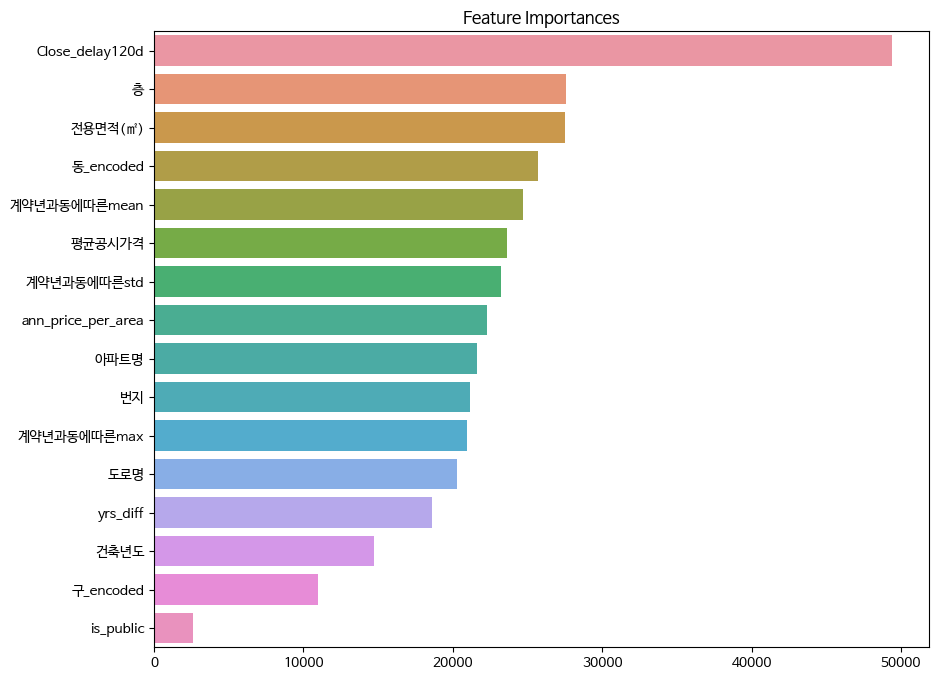

In [434]:
# 위 feature importance를 시각화해봅니다.
importances = pd.Series(gbm0.feature_importances_, index=list(X_train0.columns))
importances = importances.sort_values(ascending=False)

plt.figure(figsize=(10,8))
plt.title("Feature Importances")
sns.barplot(x=importances, y=importances.index)
plt.show()

In [435]:
# Permutation importance 방법을 변수 선택에 이용해보겠습니다.
perm = PermutationImportance(gbm0,        # 위에서 학습된 모델을 이용하겠습니다.
                             scoring = "neg_mean_squared_error",        # 평가 지표로는 회귀문제이기에 negative rmse를 사용합니다. (neg_mean_squared_error : 음의 평균 제곱 오차)
                             random_state = 42,
                             n_iter=3).fit(X_val0, y_val0)
eli5.show_weights(perm, feature_names = X_val0.columns.tolist())    # valid data에 대해 적합시킵니다.

Weight,Feature
599044737.5728 ± 16769878.9348,평균공시가격
156204388.9801 ± 4472919.5751,계약년과동에따른mean
113599836.2632 ± 959314.3256,건축년도
111924979.8148 ± 3709258.5205,전용면적(㎡)
92905206.9027 ± 2152552.3939,yrs_diff
48538798.6249 ± 652035.7148,Close_delay120d
25150213.0257 ± 353631.3853,구_encoded
21917483.5150 ± 741848.9316,계약년과동에따른std
19333746.6243 ± 550945.8321,동_encoded
10809272.2450 ± 263355.1382,ann_price_per_area


In [ ]:

X_train60, X_val60, y_train60, y_val60 = train_test_split(X_train60, y_train60, test_size=0.2, random_state=2023)

In [ ]:

print(X_train60.shape, X_val60.shape)

In [ ]:


gbm60 = lgb.LGBMRegressor(n_estimators=5000, max_depth=50, num_leaves=600, min_child_samples=30,
                            feature_fraction=0.7,
                            bagging_fraction=0.9, verbosity=-1)

In [360]:
gbm60.fit(
        X_train60, y_train60, 
        eval_set=[(X_train60, y_train60), (X_val60, y_val60)], 
        eval_metric='rmse',
        callbacks=[lgb.early_stopping(stopping_rounds=50),
                   lgb.log_evaluation(period=100, show_stdv=True)]
        )

Training until validation scores don't improve for 50 rounds
[100]	training's rmse: 5712.49	training's l2: 3.26326e+07	valid_1's rmse: 7328.33	valid_1's l2: 5.37045e+07
[200]	training's rmse: 4539.21	training's l2: 2.06044e+07	valid_1's rmse: 6766.61	valid_1's l2: 4.5787e+07
[300]	training's rmse: 3989.23	training's l2: 1.5914e+07	valid_1's rmse: 6609.42	valid_1's l2: 4.36845e+07
[400]	training's rmse: 3611.27	training's l2: 1.30413e+07	valid_1's rmse: 6540.23	valid_1's l2: 4.27746e+07
[500]	training's rmse: 3307.28	training's l2: 1.09381e+07	valid_1's rmse: 6497.73	valid_1's l2: 4.22204e+07
[600]	training's rmse: 3062.8	training's l2: 9.38073e+06	valid_1's rmse: 6479.19	valid_1's l2: 4.19799e+07
[700]	training's rmse: 2857.17	training's l2: 8.16343e+06	valid_1's rmse: 6466.14	valid_1's l2: 4.1811e+07
[800]	training's rmse: 2680.14	training's l2: 7.18315e+06	valid_1's rmse: 6458.52	valid_1's l2: 4.17124e+07
Early stopping, best iteration is:
[787]	training's rmse: 2701.59	training's l2

LGBMRegressor(bagging_fraction=0.9, feature_fraction=0.7, max_depth=50,
              min_child_samples=30, n_estimators=5000, num_leaves=600,
              verbosity=-1)

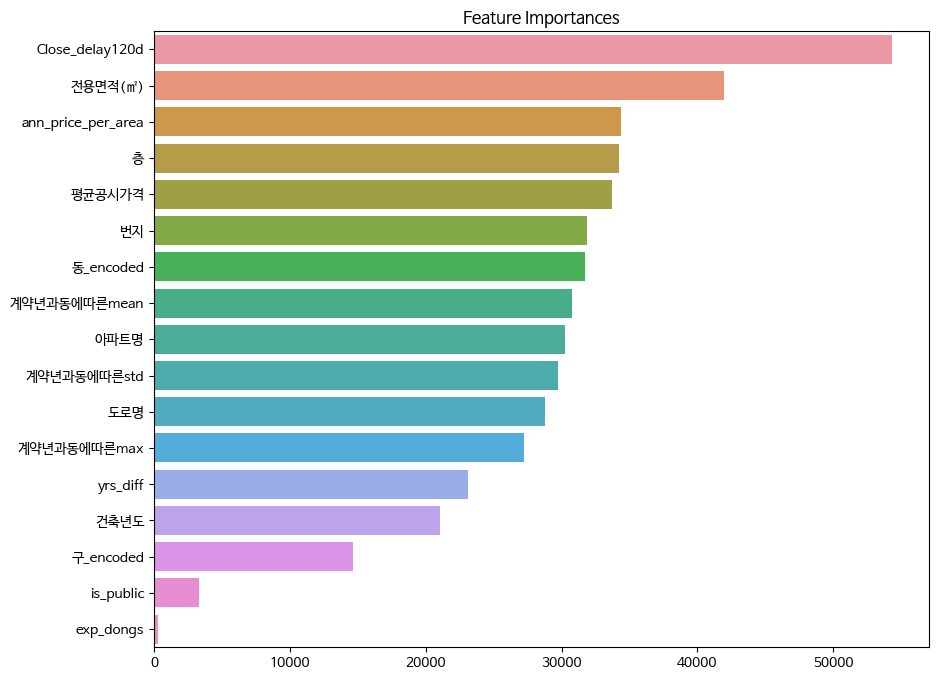

In [361]:
# 위 feature importance를 시각화해봅니다.
importances = pd.Series(gbm60.feature_importances_, index=list(X_train60.columns))
importances = importances.sort_values(ascending=False)

plt.figure(figsize=(10,8))
plt.title("Feature Importances")
sns.barplot(x=importances, y=importances.index)
plt.show()

In [362]:
# Permutation importance 방법을 변수 선택에 이용해보겠습니다.
perm = PermutationImportance(gbm60,        # 위에서 학습된 모델을 이용하겠습니다.
                             scoring = "neg_mean_squared_error",        # 평가 지표로는 회귀문제이기에 negative rmse를 사용합니다. (neg_mean_squared_error : 음의 평균 제곱 오차)
                             random_state = 42,
                             n_iter=3).fit(X_val60, y_val60)
eli5.show_weights(perm, feature_names = X_val60.columns.tolist())    # valid data에 대해 적합시킵니다.

Weight,Feature
1113292857.5306 ± 7871893.1140,평균공시가격
329571894.6208 ± 4223132.5835,건축년도
273516688.3732 ± 3002589.8229,yrs_diff
177513364.3562 ± 2426073.7248,계약년과동에따른mean
140422165.2801 ± 2765586.0043,전용면적(㎡)
118940663.1462 ± 862453.5502,계약년과동에따른std
94204774.9350 ± 1418969.5726,Close_delay120d
66599134.5848 ± 397002.8479,구_encoded
61557089.9204 ± 1045771.9441,동_encoded
38959487.6935 ± 554610.4356,ann_price_per_area


### 135만 다르게 접근해야할 것 같음

In [252]:
print(X_train0.shape, X_val0.shape)
print(X_train60.shape, X_val60.shape)

(196015, 17) (49004, 17)
(291853, 17) (72964, 17)


In [ ]:
from sklearn.model_selection import KFold
from eli5.sklearn import PermutationImportance

# Modify the objective function to use cross-validation
def objective(trial, X, y):
    # Define the hyperparameter search space
    params = {
        'n_estimators': trial.suggest_int('n_estimators', 1000, 5000),
        'max_depth': trial.suggest_int('max_depth', 10, 50),
        'num_leaves': trial.suggest_int('num_leaves', 100, 1000),
        'min_child_samples': trial.suggest_int('min_child_samples', 50, 500),
        'feature_fraction': trial.suggest_float('feature_fraction', 0.5, 1.0),
        'bagging_fraction': trial.suggest_float('bagging_fraction', 0.5, 1.0),
        'lambda_l1': trial.suggest_float('lambda_l1', 1e-8, 1.0, log=True),
        'lambda_l2': trial.suggest_float('lambda_l2', 1e-8, 1.0, log=True)
    }

    # Initialize a LightGBM regressor with the suggested hyperparameters
    gbm = lgb.LGBMRegressor(**params)

    # Perform k-fold cross-validation
    kf = KFold(n_splits=5, shuffle=True, random_state=2023)
    val_scores = []
    base_learners = []
    perms = []
    for train_idx, val_idx in kf.split(X):
        X_train_fold, X_val_fold = X.iloc[train_idx], X.iloc[val_idx]
        y_train_fold, y_val_fold = y.iloc[train_idx], y.iloc[val_idx]

        # Train the model
        gbm.fit(X_train_fold, y_train_fold, eval_set=[(X_val_fold, y_val_fold)], eval_metric='rmse', 
                callbacks=[lgb.early_stopping(stopping_rounds=50),
                           lgb.log_evaluation(period=100, show_stdv=True)]
                )

        # Compute validation RMSE
        val_score = gbm.best_score_['valid_0']['rmse']
        val_scores.append(val_score)
        
        base_learners.append(gbm)        
        perm = PermutationImportance(gbm, scoring="neg_mean_squared_error", random_state=42, n_iter=3).fit(X_val_fold, y_val_fold)
        perms.append(perm)

    # Return the mean of validation RMSE scores as the objective value
    return np.mean(val_scores), base_learners, perms

def optimize_hyperparameters(n_trials=100, X=None, y=None):
    if X is None or y is None:
        raise ValueError("X and y must be provided.")

    study = optuna.create_study(direction='minimize', sampler=optuna.samplers.TPESampler(seed=42))
    study.optimize(lambda trial: objective(trial, X, y), n_trials=n_trials)

    # Get the best hyperparameters
    best_params = study.best_trial.params

    return best_params

In [ ]:
# # gbm0_best_params = optimize_hyperparameters(n_trials=20, X=X_train0, y=y_train0)
# # gbm0_base_learners, gbm0_perms = gbm0_best_params[-2], gbm0_best_params[-1]

# # Iterate over the base learners to print train and validation RMSE
# for idx, gbm in enumerate(gbm0_base_learners):
#     print(f"Model {idx + 1}:")
#     for fold, (_, val_idx) in enumerate(kf.split(X_train0), 1):
#         X_val_fold, y_val_fold = X_train0.iloc[val_idx], y_train0.iloc[val_idx]
#         # Compute validation RMSE for this fold
#         val_rmse = np.sqrt(mean_squared_error(y_val_fold, gbm.predict(X_val_fold)))
#         print(f"Fold {fold} - Validation RMSE: {val_rmse:.4f}")

#     # Compute train RMSE
#     train_rmse = np.sqrt(mean_squared_error(y_train0, gbm.predict(X_train0)))
#     print(f"Overall Train RMSE: {train_rmse:.4f}")
#     print()


In [257]:
X_train135.drop(columns=drop_col_over135, inplace=True)

In [ ]:
X_test135.drop(columns=drop_col_over135, inplace=True)

In [258]:
X_train135.shape

(26900, 18)

In [264]:
# Usage example
best_hyperparams = optimize_hyperparameters(n_trials=100, X=X_train135, y=y_train135)
base_learners = train_base_learners(X_train135, y_train135)

[I 2024-04-01 06:46:48,438] A new study created in memory with name: no-name-39d8bf40-f941-42ee-94b9-b2d5521ec3f5


[LightGBM] [Warning] feature_fraction is set=0.5780093202212182, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.5780093202212182
[LightGBM] [Warning] lambda_l2 is set=0.08499808989182997, reg_lambda=0.0 will be ignored. Current value: lambda_l2=0.08499808989182997
[LightGBM] [Warning] lambda_l1 is set=2.9152036385288193e-08, reg_alpha=0.0 will be ignored. Current value: lambda_l1=2.9152036385288193e-08
[LightGBM] [Warning] bagging_fraction is set=0.5779972601681014, subsample=1.0 will be ignored. Current value: bagging_fraction=0.5779972601681014
[LightGBM] [Warning] feature_fraction is set=0.5780093202212182, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.5780093202212182
[LightGBM] [Warning] lambda_l2 is set=0.08499808989182997, reg_lambda=0.0 will be ignored. Current value: lambda_l2=0.08499808989182997
[LightGBM] [Warning] lambda_l1 is set=2.9152036385288193e-08, reg_alpha=0.0 will be ignored. Current value: lambda_l1=2.915203638528

[I 2024-04-01 06:47:05,831] Trial 0 finished with value: 9466.079688832167 and parameters: {'n_estimators': 2498, 'max_depth': 48, 'num_leaves': 759, 'min_child_samples': 319, 'feature_fraction': 0.5780093202212182, 'bagging_fraction': 0.5779972601681014, 'lambda_l1': 2.9152036385288193e-08, 'lambda_l2': 0.08499808989182997}. Best is trial 0 with value: 9466.079688832167.


[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No f

[I 2024-04-01 06:47:39,086] Trial 1 finished with value: 10185.819329435513 and parameters: {'n_estimators': 3405, 'max_depth': 39, 'num_leaves': 118, 'min_child_samples': 487, 'feature_fraction': 0.9162213204002109, 'bagging_fraction': 0.6061695553391381, 'lambda_l1': 2.8483918709107956e-07, 'lambda_l2': 2.9324868872723725e-07}. Best is trial 0 with value: 9466.079688832167.


[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No f

[I 2024-04-01 06:47:58,228] Trial 2 finished with value: 8478.496452653906 and parameters: {'n_estimators': 2217, 'max_depth': 31, 'num_leaves': 489, 'min_child_samples': 181, 'feature_fraction': 0.8059264473611898, 'bagging_fraction': 0.569746930326021, 'lambda_l1': 2.1734877073417355e-06, 'lambda_l2': 8.528933855762793e-06}. Best is trial 2 with value: 8478.496452653906.


[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No f

[I 2024-04-01 06:48:16,554] Trial 3 finished with value: 9521.892855691642 and parameters: {'n_estimators': 2824, 'max_depth': 42, 'num_leaves': 279, 'min_child_samples': 281, 'feature_fraction': 0.7962072844310213, 'bagging_fraction': 0.5232252063599989, 'lambda_l1': 0.0007250347382396634, 'lambda_l2': 2.3130924416844053e-07}. Best is trial 2 with value: 8478.496452653906.


[LightGBM] [Warning] feature_fraction is set=0.6523068845866853, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.6523068845866853
[LightGBM] [Warning] lambda_l2 is set=3.320625892007924e-05, reg_lambda=0.0 will be ignored. Current value: lambda_l2=3.320625892007924e-05
[LightGBM] [Warning] lambda_l1 is set=0.0029775853025212607, reg_alpha=0.0 will be ignored. Current value: lambda_l1=0.0029775853025212607
[LightGBM] [Warning] bagging_fraction is set=0.5488360570031919, subsample=1.0 will be ignored. Current value: bagging_fraction=0.5488360570031919
[LightGBM] [Warning] feature_fraction is set=0.6523068845866853, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.6523068845866853
[LightGBM] [Warning] lambda_l2 is set=3.320625892007924e-05, reg_lambda=0.0 will be ignored. Current value: lambda_l2=3.320625892007924e-05
[LightGBM] [Warning] lambda_l1 is set=0.0029775853025212607, reg_alpha=0.0 will be ignored. Current value: lambda_l1=0.0029775

[I 2024-04-01 06:48:25,230] Trial 4 finished with value: 10963.196066891205 and parameters: {'n_estimators': 1260, 'max_depth': 48, 'num_leaves': 970, 'min_child_samples': 414, 'feature_fraction': 0.6523068845866853, 'bagging_fraction': 0.5488360570031919, 'lambda_l1': 0.0029775853025212607, 'lambda_l2': 3.320625892007924e-05}. Best is trial 2 with value: 8478.496452653906.


[LightGBM] [Warning] feature_fraction is set=0.6293899908000085, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.6293899908000085
[LightGBM] [Warning] lambda_l2 is set=0.00014472520367197597, reg_lambda=0.0 will be ignored. Current value: lambda_l2=0.00014472520367197597
[LightGBM] [Warning] lambda_l1 is set=3.116654126398047e-06, reg_alpha=0.0 will be ignored. Current value: lambda_l1=3.116654126398047e-06
[LightGBM] [Warning] bagging_fraction is set=0.831261142176991, subsample=1.0 will be ignored. Current value: bagging_fraction=0.831261142176991
[LightGBM] [Warning] feature_fraction is set=0.6293899908000085, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.6293899908000085
[LightGBM] [Warning] lambda_l2 is set=0.00014472520367197597, reg_lambda=0.0 will be ignored. Current value: lambda_l2=0.00014472520367197597
[LightGBM] [Warning] lambda_l1 is set=3.116654126398047e-06, reg_alpha=0.0 will be ignored. Current value: lambda_l1=3.11665

[I 2024-04-01 06:48:34,512] Trial 5 finished with value: 11332.233388714158 and parameters: {'n_estimators': 1488, 'max_depth': 30, 'num_leaves': 130, 'min_child_samples': 460, 'feature_fraction': 0.6293899908000085, 'bagging_fraction': 0.831261142176991, 'lambda_l1': 3.116654126398047e-06, 'lambda_l2': 0.00014472520367197597}. Best is trial 2 with value: 8478.496452653906.


[LightGBM] [Warning] feature_fraction is set=0.9697494707820946, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.9697494707820946
[LightGBM] [Warning] lambda_l2 is set=0.23713402899336497, reg_lambda=0.0 will be ignored. Current value: lambda_l2=0.23713402899336497
[LightGBM] [Warning] lambda_l1 is set=0.0006070155694141794, reg_alpha=0.0 will be ignored. Current value: lambda_l1=0.0006070155694141794
[LightGBM] [Warning] bagging_fraction is set=0.9474136752138245, subsample=1.0 will be ignored. Current value: bagging_fraction=0.9474136752138245
[LightGBM] [Warning] feature_fraction is set=0.9697494707820946, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.9697494707820946
[LightGBM] [Warning] lambda_l2 is set=0.23713402899336497, reg_lambda=0.0 will be ignored. Current value: lambda_l2=0.23713402899336497
[LightGBM] [Warning] lambda_l1 is set=0.0006070155694141794, reg_alpha=0.0 will be ignored. Current value: lambda_l1=0.000607015569414

[I 2024-04-01 06:48:51,570] Trial 6 finished with value: 10232.421861603983 and parameters: {'n_estimators': 3187, 'max_depth': 17, 'num_leaves': 973, 'min_child_samples': 399, 'feature_fraction': 0.9697494707820946, 'bagging_fraction': 0.9474136752138245, 'lambda_l1': 0.0006070155694141794, 'lambda_l2': 0.23713402899336497}. Best is trial 2 with value: 8478.496452653906.


[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No f

[I 2024-04-01 06:49:00,167] Trial 7 finished with value: 8799.879404784064 and parameters: {'n_estimators': 1354, 'max_depth': 18, 'num_leaves': 140, 'min_child_samples': 196, 'feature_fraction': 0.6943386448447411, 'bagging_fraction': 0.6356745158869479, 'lambda_l1': 0.04264813784432918, 'lambda_l2': 7.145401117237584e-06}. Best is trial 2 with value: 8478.496452653906.


[LightGBM] [Warning] feature_fraction is set=0.5372753218398854, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.5372753218398854
[LightGBM] [Warning] lambda_l2 is set=3.8879928024075543e-07, reg_lambda=0.0 will be ignored. Current value: lambda_l2=3.8879928024075543e-07
[LightGBM] [Warning] lambda_l1 is set=0.015064619068942013, reg_alpha=0.0 will be ignored. Current value: lambda_l1=0.015064619068942013
[LightGBM] [Warning] bagging_fraction is set=0.9934434683002586, subsample=1.0 will be ignored. Current value: bagging_fraction=0.9934434683002586
[LightGBM] [Warning] feature_fraction is set=0.5372753218398854, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.5372753218398854
[LightGBM] [Warning] lambda_l2 is set=3.8879928024075543e-07, reg_lambda=0.0 will be ignored. Current value: lambda_l2=3.8879928024075543e-07
[LightGBM] [Warning] lambda_l1 is set=0.015064619068942013, reg_alpha=0.0 will be ignored. Current value: lambda_l1=0.015064

[I 2024-04-01 06:49:19,270] Trial 8 finished with value: 10150.234424928165 and parameters: {'n_estimators': 2124, 'max_depth': 32, 'num_leaves': 226, 'min_child_samples': 411, 'feature_fraction': 0.5372753218398854, 'bagging_fraction': 0.9934434683002586, 'lambda_l1': 0.015064619068942013, 'lambda_l2': 3.8879928024075543e-07}. Best is trial 2 with value: 8478.496452653906.


[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[2100]	valid_0's rmse: 10993	valid_0's l2: 1.20846e+08
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with p

[I 2024-04-01 06:49:27,311] Trial 9 finished with value: 10807.727838631314 and parameters: {'n_estimators': 1022, 'max_depth': 43, 'num_leaves': 736, 'min_child_samples': 378, 'feature_fraction': 0.8856351733429728, 'bagging_fraction': 0.5370223258670452, 'lambda_l1': 7.374385355858303e-06, 'lambda_l2': 8.451863533931625e-08}. Best is trial 2 with value: 8478.496452653906.


[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No f

[I 2024-04-01 06:49:34,067] Trial 10 finished with value: 6198.395415914295 and parameters: {'n_estimators': 4465, 'max_depth': 10, 'num_leaves': 432, 'min_child_samples': 58, 'feature_fraction': 0.7846562513261506, 'bagging_fraction': 0.721539898400351, 'lambda_l1': 0.4766130918149966, 'lambda_l2': 0.0021620523265932223}. Best is trial 10 with value: 6198.395415914295.


[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No f

[I 2024-04-01 06:49:40,357] Trial 11 finished with value: 6173.06912616117 and parameters: {'n_estimators': 4788, 'max_depth': 10, 'num_leaves': 434, 'min_child_samples': 54, 'feature_fraction': 0.7930679183446125, 'bagging_fraction': 0.7171781358782056, 'lambda_l1': 0.4613646571020784, 'lambda_l2': 0.0018504237648254201}. Best is trial 11 with value: 6173.06912616117.


[LightGBM] [Warning] feature_fraction is set=0.7447014489005493, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.7447014489005493
[LightGBM] [Warning] lambda_l2 is set=0.0030509958710741554, reg_lambda=0.0 will be ignored. Current value: lambda_l2=0.0030509958710741554
[LightGBM] [Warning] lambda_l1 is set=0.9074129041695244, reg_alpha=0.0 will be ignored. Current value: lambda_l1=0.9074129041695244
[LightGBM] [Warning] bagging_fraction is set=0.7372735823178598, subsample=1.0 will be ignored. Current value: bagging_fraction=0.7372735823178598
[LightGBM] [Warning] feature_fraction is set=0.7447014489005493, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.7447014489005493
[LightGBM] [Warning] lambda_l2 is set=0.0030509958710741554, reg_lambda=0.0 will be ignored. Current value: lambda_l2=0.0030509958710741554
[LightGBM] [Warning] lambda_l1 is set=0.9074129041695244, reg_alpha=0.0 will be ignored. Current value: lambda_l1=0.9074129041695244

[I 2024-04-01 06:49:49,089] Trial 12 finished with value: 6097.181200085772 and parameters: {'n_estimators': 4890, 'max_depth': 10, 'num_leaves': 461, 'min_child_samples': 51, 'feature_fraction': 0.7447014489005493, 'bagging_fraction': 0.7372735823178598, 'lambda_l1': 0.9074129041695244, 'lambda_l2': 0.0030509958710741554}. Best is trial 12 with value: 6097.181200085772.


[LightGBM] [Warning] feature_fraction is set=0.7290238266702316, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.7290238266702316
[LightGBM] [Warning] lambda_l2 is set=0.005311012452742682, reg_lambda=0.0 will be ignored. Current value: lambda_l2=0.005311012452742682
[LightGBM] [Warning] lambda_l1 is set=0.9883243810305332, reg_alpha=0.0 will be ignored. Current value: lambda_l1=0.9883243810305332
[LightGBM] [Warning] bagging_fraction is set=0.7574852070104715, subsample=1.0 will be ignored. Current value: bagging_fraction=0.7574852070104715
[LightGBM] [Warning] feature_fraction is set=0.7290238266702316, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.7290238266702316
[LightGBM] [Warning] lambda_l2 is set=0.005311012452742682, reg_lambda=0.0 will be ignored. Current value: lambda_l2=0.005311012452742682
[LightGBM] [Warning] lambda_l1 is set=0.9883243810305332, reg_alpha=0.0 will be ignored. Current value: lambda_l1=0.9883243810305332
[Li

[I 2024-04-01 06:49:57,779] Trial 13 finished with value: 6368.787963484315 and parameters: {'n_estimators': 4964, 'max_depth': 11, 'num_leaves': 360, 'min_child_samples': 54, 'feature_fraction': 0.7290238266702316, 'bagging_fraction': 0.7574852070104715, 'lambda_l1': 0.9883243810305332, 'lambda_l2': 0.005311012452742682}. Best is trial 12 with value: 6097.181200085772.


[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[400]	valid_0's rmse: 7760.25	valid_0's l2: 6.02215e+07
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with 

[I 2024-04-01 06:50:04,307] Trial 14 finished with value: 7224.683041192834 and parameters: {'n_estimators': 4045, 'max_depth': 20, 'num_leaves': 623, 'min_child_samples': 121, 'feature_fraction': 0.8649174147658507, 'bagging_fraction': 0.6864335476087042, 'lambda_l1': 0.08521162942761736, 'lambda_l2': 0.0029750536488331292}. Best is trial 12 with value: 6097.181200085772.


[LightGBM] [Warning] feature_fraction is set=0.7261631564388041, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.7261631564388041
[LightGBM] [Warning] lambda_l2 is set=0.022759510272481517, reg_lambda=0.0 will be ignored. Current value: lambda_l2=0.022759510272481517
[LightGBM] [Warning] lambda_l1 is set=5.552629842495186e-05, reg_alpha=0.0 will be ignored. Current value: lambda_l1=5.552629842495186e-05
[LightGBM] [Warning] bagging_fraction is set=0.8295143024044869, subsample=1.0 will be ignored. Current value: bagging_fraction=0.8295143024044869
[LightGBM] [Warning] feature_fraction is set=0.7261631564388041, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.7261631564388041
[LightGBM] [Warning] lambda_l2 is set=0.022759510272481517, reg_lambda=0.0 will be ignored. Current value: lambda_l2=0.022759510272481517
[LightGBM] [Warning] lambda_l1 is set=5.552629842495186e-05, reg_alpha=0.0 will be ignored. Current value: lambda_l1=5.55262984249

[I 2024-04-01 06:50:15,126] Trial 15 finished with value: 7709.63982523483 and parameters: {'n_estimators': 4998, 'max_depth': 22, 'num_leaves': 600, 'min_child_samples': 132, 'feature_fraction': 0.7261631564388041, 'bagging_fraction': 0.8295143024044869, 'lambda_l1': 5.552629842495186e-05, 'lambda_l2': 0.022759510272481517}. Best is trial 12 with value: 6097.181200085772.


[LightGBM] [Warning] feature_fraction is set=0.8352725713024431, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.8352725713024431
[LightGBM] [Warning] lambda_l2 is set=0.00028823524295860356, reg_lambda=0.0 will be ignored. Current value: lambda_l2=0.00028823524295860356
[LightGBM] [Warning] lambda_l1 is set=0.1777965521668052, reg_alpha=0.0 will be ignored. Current value: lambda_l1=0.1777965521668052
[LightGBM] [Warning] bagging_fraction is set=0.7997509191284597, subsample=1.0 will be ignored. Current value: bagging_fraction=0.7997509191284597
[LightGBM] [Warning] feature_fraction is set=0.8352725713024431, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.8352725713024431
[LightGBM] [Warning] lambda_l2 is set=0.00028823524295860356, reg_lambda=0.0 will be ignored. Current value: lambda_l2=0.00028823524295860356
[LightGBM] [Warning] lambda_l1 is set=0.1777965521668052, reg_alpha=0.0 will be ignored. Current value: lambda_l1=0.177796552166

[I 2024-04-01 06:50:20,761] Trial 16 finished with value: 7573.443997087001 and parameters: {'n_estimators': 4023, 'max_depth': 14, 'num_leaves': 367, 'min_child_samples': 123, 'feature_fraction': 0.8352725713024431, 'bagging_fraction': 0.7997509191284597, 'lambda_l1': 0.1777965521668052, 'lambda_l2': 0.00028823524295860356}. Best is trial 12 with value: 6097.181200085772.


[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No f

[I 2024-04-01 06:50:34,346] Trial 17 finished with value: 8916.904173689869 and parameters: {'n_estimators': 4397, 'max_depth': 24, 'num_leaves': 528, 'min_child_samples': 224, 'feature_fraction': 0.6584230782726497, 'bagging_fraction': 0.9025062940679403, 'lambda_l1': 0.007121989271776358, 'lambda_l2': 0.5192738836470003}. Best is trial 12 with value: 6097.181200085772.


[LightGBM] [Warning] feature_fraction is set=0.9935651677707863, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.9935651677707863
[LightGBM] [Warning] lambda_l2 is set=0.0006236403742545095, reg_lambda=0.0 will be ignored. Current value: lambda_l2=0.0006236403742545095
[LightGBM] [Warning] lambda_l1 is set=0.9878857688000914, reg_alpha=0.0 will be ignored. Current value: lambda_l1=0.9878857688000914
[LightGBM] [Warning] bagging_fraction is set=0.6601698676289584, subsample=1.0 will be ignored. Current value: bagging_fraction=0.6601698676289584
[LightGBM] [Warning] feature_fraction is set=0.9935651677707863, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.9935651677707863
[LightGBM] [Warning] lambda_l2 is set=0.0006236403742545095, reg_lambda=0.0 will be ignored. Current value: lambda_l2=0.0006236403742545095
[LightGBM] [Warning] lambda_l1 is set=0.9878857688000914, reg_alpha=0.0 will be ignored. Current value: lambda_l1=0.9878857688000914

[I 2024-04-01 06:50:43,009] Trial 18 finished with value: 7001.14548539858 and parameters: {'n_estimators': 3655, 'max_depth': 26, 'num_leaves': 698, 'min_child_samples': 96, 'feature_fraction': 0.9935651677707863, 'bagging_fraction': 0.6601698676289584, 'lambda_l1': 0.9878857688000914, 'lambda_l2': 0.0006236403742545095}. Best is trial 12 with value: 6097.181200085772.


[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No f

[I 2024-04-01 06:50:52,937] Trial 19 finished with value: 8514.575538578241 and parameters: {'n_estimators': 4518, 'max_depth': 14, 'num_leaves': 823, 'min_child_samples': 182, 'feature_fraction': 0.7544572512626753, 'bagging_fraction': 0.7507285077111834, 'lambda_l1': 0.060256962758011214, 'lambda_l2': 0.03356129409271225}. Best is trial 12 with value: 6097.181200085772.


[LightGBM] [Warning] feature_fraction is set=0.9292066062055611, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.9292066062055611
[LightGBM] [Warning] lambda_l2 is set=0.012219233744176427, reg_lambda=0.0 will be ignored. Current value: lambda_l2=0.012219233744176427
[LightGBM] [Warning] lambda_l1 is set=7.388223725776035e-05, reg_alpha=0.0 will be ignored. Current value: lambda_l1=7.388223725776035e-05
[LightGBM] [Warning] bagging_fraction is set=0.8729962996958589, subsample=1.0 will be ignored. Current value: bagging_fraction=0.8729962996958589
[LightGBM] [Warning] feature_fraction is set=0.9292066062055611, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.9292066062055611
[LightGBM] [Warning] lambda_l2 is set=0.012219233744176427, reg_lambda=0.0 will be ignored. Current value: lambda_l2=0.012219233744176427
[LightGBM] [Warning] lambda_l1 is set=7.388223725776035e-05, reg_alpha=0.0 will be ignored. Current value: lambda_l1=7.38822372577

[I 2024-04-01 06:51:05,095] Trial 20 finished with value: 8722.337127889483 and parameters: {'n_estimators': 4118, 'max_depth': 14, 'num_leaves': 441, 'min_child_samples': 243, 'feature_fraction': 0.9292066062055611, 'bagging_fraction': 0.8729962996958589, 'lambda_l1': 7.388223725776035e-05, 'lambda_l2': 0.012219233744176427}. Best is trial 12 with value: 6097.181200085772.


[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
Early stopping, best iteration is:
[2314]	valid_0's rmse: 9514.05	valid_0's l2: 9.05172e+07
[LightGBM] [Warning] feature_fraction is set=0.7666948077315919, colsample_bytree=1

[I 2024-04-01 06:51:14,278] Trial 21 finished with value: 6101.685999023694 and parameters: {'n_estimators': 4616, 'max_depth': 10, 'num_leaves': 402, 'min_child_samples': 51, 'feature_fraction': 0.7666948077315919, 'bagging_fraction': 0.6987241530079855, 'lambda_l1': 0.40937565285525257, 'lambda_l2': 0.0012329864813600563}. Best is trial 12 with value: 6097.181200085772.


[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No f

[I 2024-04-01 06:51:18,269] Trial 22 finished with value: 7434.908373133342 and parameters: {'n_estimators': 4697, 'max_depth': 10, 'num_leaves': 339, 'min_child_samples': 84, 'feature_fraction': 0.7601867101850032, 'bagging_fraction': 0.709486580052908, 'lambda_l1': 0.27580155937499545, 'lambda_l2': 0.0009431425540515761}. Best is trial 12 with value: 6097.181200085772.


[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No f

[I 2024-04-01 06:51:29,340] Trial 23 finished with value: 6092.067190424985 and parameters: {'n_estimators': 3765, 'max_depth': 16, 'num_leaves': 447, 'min_child_samples': 52, 'feature_fraction': 0.8293948872008855, 'bagging_fraction': 0.7939290159204693, 'lambda_l1': 0.018176908102991416, 'lambda_l2': 4.901100023688675e-05}. Best is trial 23 with value: 6092.067190424985.


[LightGBM] [Warning] feature_fraction is set=0.8634452252188971, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.8634452252188971
[LightGBM] [Warning] lambda_l2 is set=2.8670986207384364e-05, reg_lambda=0.0 will be ignored. Current value: lambda_l2=2.8670986207384364e-05
[LightGBM] [Warning] lambda_l1 is set=0.019679111563566984, reg_alpha=0.0 will be ignored. Current value: lambda_l1=0.019679111563566984
[LightGBM] [Warning] bagging_fraction is set=0.7849527378148702, subsample=1.0 will be ignored. Current value: bagging_fraction=0.7849527378148702
[LightGBM] [Warning] feature_fraction is set=0.8634452252188971, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.8634452252188971
[LightGBM] [Warning] lambda_l2 is set=2.8670986207384364e-05, reg_lambda=0.0 will be ignored. Current value: lambda_l2=2.8670986207384364e-05
[LightGBM] [Warning] lambda_l1 is set=0.019679111563566984, reg_alpha=0.0 will be ignored. Current value: lambda_l1=0.019679

[I 2024-04-01 06:51:36,221] Trial 24 finished with value: 7630.676390513455 and parameters: {'n_estimators': 3670, 'max_depth': 16, 'num_leaves': 255, 'min_child_samples': 146, 'feature_fraction': 0.8634452252188971, 'bagging_fraction': 0.7849527378148702, 'lambda_l1': 0.019679111563566984, 'lambda_l2': 2.8670986207384364e-05}. Best is trial 23 with value: 6092.067190424985.


[LightGBM] [Warning] feature_fraction is set=0.8421296974546876, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.8421296974546876
[LightGBM] [Warning] lambda_l2 is set=2.8523820828714262e-06, reg_lambda=0.0 will be ignored. Current value: lambda_l2=2.8523820828714262e-06
[LightGBM] [Warning] lambda_l1 is set=0.0005783229195020054, reg_alpha=0.0 will be ignored. Current value: lambda_l1=0.0005783229195020054
[LightGBM] [Warning] bagging_fraction is set=0.6601193275404629, subsample=1.0 will be ignored. Current value: bagging_fraction=0.6601193275404629
[LightGBM] [Warning] feature_fraction is set=0.8421296974546876, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.8421296974546876
[LightGBM] [Warning] lambda_l2 is set=2.8523820828714262e-06, reg_lambda=0.0 will be ignored. Current value: lambda_l2=2.8523820828714262e-06
[LightGBM] [Warning] lambda_l1 is set=0.0005783229195020054, reg_alpha=0.0 will be ignored. Current value: lambda_l1=0.000

[I 2024-04-01 06:51:45,844] Trial 25 finished with value: 7277.303326315241 and parameters: {'n_estimators': 4305, 'max_depth': 26, 'num_leaves': 602, 'min_child_samples': 93, 'feature_fraction': 0.8421296974546876, 'bagging_fraction': 0.6601193275404629, 'lambda_l1': 0.0005783229195020054, 'lambda_l2': 2.8523820828714262e-06}. Best is trial 23 with value: 6092.067190424985.


[LightGBM] [Warning] feature_fraction is set=0.6963193704521311, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.6963193704521311
[LightGBM] [Warning] lambda_l2 is set=6.381400053348308e-05, reg_lambda=0.0 will be ignored. Current value: lambda_l2=6.381400053348308e-05
[LightGBM] [Warning] lambda_l1 is set=0.0034068481975137264, reg_alpha=0.0 will be ignored. Current value: lambda_l1=0.0034068481975137264
[LightGBM] [Warning] bagging_fraction is set=0.7936347090519561, subsample=1.0 will be ignored. Current value: bagging_fraction=0.7936347090519561
[LightGBM] [Warning] feature_fraction is set=0.6963193704521311, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.6963193704521311
[LightGBM] [Warning] lambda_l2 is set=6.381400053348308e-05, reg_lambda=0.0 will be ignored. Current value: lambda_l2=6.381400053348308e-05
[LightGBM] [Warning] lambda_l1 is set=0.0034068481975137264, reg_alpha=0.0 will be ignored. Current value: lambda_l1=0.0034068

[I 2024-04-01 06:51:55,346] Trial 26 finished with value: 7914.941795431473 and parameters: {'n_estimators': 3760, 'max_depth': 20, 'num_leaves': 515, 'min_child_samples': 147, 'feature_fraction': 0.6963193704521311, 'bagging_fraction': 0.7936347090519561, 'lambda_l1': 0.0034068481975137264, 'lambda_l2': 6.381400053348308e-05}. Best is trial 23 with value: 6092.067190424985.


[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No f

[I 2024-04-01 06:52:00,374] Trial 27 finished with value: 7402.552594786865 and parameters: {'n_estimators': 4726, 'max_depth': 13, 'num_leaves': 322, 'min_child_samples': 92, 'feature_fraction': 0.825377631411361, 'bagging_fraction': 0.8538132936477462, 'lambda_l1': 0.1397563812584199, 'lambda_l2': 0.0001700939588151399}. Best is trial 23 with value: 6092.067190424985.


[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No f

[I 2024-04-01 06:52:15,683] Trial 28 finished with value: 9287.753672530722 and parameters: {'n_estimators': 3255, 'max_depth': 17, 'num_leaves': 407, 'min_child_samples': 326, 'feature_fraction': 0.6882859332996788, 'bagging_fraction': 0.7616620871461558, 'lambda_l1': 0.03983860019259117, 'lambda_l2': 1.5945155621686682e-08}. Best is trial 23 with value: 6092.067190424985.


[LightGBM] [Warning] feature_fraction is set=0.591595171683922, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.591595171683922
[LightGBM] [Warning] lambda_l2 is set=0.08959635592581086, reg_lambda=0.0 will be ignored. Current value: lambda_l2=0.08959635592581086
[LightGBM] [Warning] lambda_l1 is set=0.007841589735235655, reg_alpha=0.0 will be ignored. Current value: lambda_l1=0.007841589735235655
[LightGBM] [Warning] bagging_fraction is set=0.6101488633362239, subsample=1.0 will be ignored. Current value: bagging_fraction=0.6101488633362239
[LightGBM] [Warning] feature_fraction is set=0.591595171683922, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.591595171683922
[LightGBM] [Warning] lambda_l2 is set=0.08959635592581086, reg_lambda=0.0 will be ignored. Current value: lambda_l2=0.08959635592581086
[LightGBM] [Warning] lambda_l1 is set=0.007841589735235655, reg_alpha=0.0 will be ignored. Current value: lambda_l1=0.007841589735235655
[Li

[I 2024-04-01 06:52:31,354] Trial 29 finished with value: 8304.515535280432 and parameters: {'n_estimators': 3887, 'max_depth': 34, 'num_leaves': 198, 'min_child_samples': 161, 'feature_fraction': 0.591595171683922, 'bagging_fraction': 0.6101488633362239, 'lambda_l1': 0.007841589735235655, 'lambda_l2': 0.08959635592581086}. Best is trial 23 with value: 6092.067190424985.


[LightGBM] [Warning] feature_fraction is set=0.7643309633067852, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.7643309633067852
[LightGBM] [Warning] lambda_l2 is set=0.0005281891527771287, reg_lambda=0.0 will be ignored. Current value: lambda_l2=0.0005281891527771287
[LightGBM] [Warning] lambda_l1 is set=2.1976647417901193e-08, reg_alpha=0.0 will be ignored. Current value: lambda_l1=2.1976647417901193e-08
[LightGBM] [Warning] bagging_fraction is set=0.6856773425522155, subsample=1.0 will be ignored. Current value: bagging_fraction=0.6856773425522155
[LightGBM] [Warning] feature_fraction is set=0.7643309633067852, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.7643309633067852
[LightGBM] [Warning] lambda_l2 is set=0.0005281891527771287, reg_lambda=0.0 will be ignored. Current value: lambda_l2=0.0005281891527771287
[LightGBM] [Warning] lambda_l1 is set=2.1976647417901193e-08, reg_alpha=0.0 will be ignored. Current value: lambda_l1=2.1976

[I 2024-04-01 06:52:41,526] Trial 30 finished with value: 6171.969296030247 and parameters: {'n_estimators': 2797, 'max_depth': 13, 'num_leaves': 653, 'min_child_samples': 72, 'feature_fraction': 0.7643309633067852, 'bagging_fraction': 0.6856773425522155, 'lambda_l1': 2.1976647417901193e-08, 'lambda_l2': 0.0005281891527771287}. Best is trial 23 with value: 6092.067190424985.


[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No f

[I 2024-04-01 06:52:51,227] Trial 31 finished with value: 6209.452937974939 and parameters: {'n_estimators': 2772, 'max_depth': 13, 'num_leaves': 676, 'min_child_samples': 51, 'feature_fraction': 0.7632001422773115, 'bagging_fraction': 0.6842102587392083, 'lambda_l1': 2.673769717306186e-08, 'lambda_l2': 0.007904676171646956}. Best is trial 23 with value: 6092.067190424985.


[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No f

[I 2024-04-01 06:53:02,669] Trial 32 finished with value: 6724.964820869209 and parameters: {'n_estimators': 2171, 'max_depth': 20, 'num_leaves': 818, 'min_child_samples': 78, 'feature_fraction': 0.7151561523600766, 'bagging_fraction': 0.729228666271262, 'lambda_l1': 0.15883671027958574, 'lambda_l2': 0.00025843575713567816}. Best is trial 23 with value: 6092.067190424985.


[LightGBM] [Warning] feature_fraction is set=0.9002689076574296, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.9002689076574296
[LightGBM] [Warning] lambda_l2 is set=0.0007238409288478901, reg_lambda=0.0 will be ignored. Current value: lambda_l2=0.0007238409288478901
[LightGBM] [Warning] lambda_l1 is set=5.283536145562071e-07, reg_alpha=0.0 will be ignored. Current value: lambda_l1=5.283536145562071e-07
[LightGBM] [Warning] bagging_fraction is set=0.6097343692903832, subsample=1.0 will be ignored. Current value: bagging_fraction=0.6097343692903832
[LightGBM] [Warning] feature_fraction is set=0.9002689076574296, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.9002689076574296
[LightGBM] [Warning] lambda_l2 is set=0.0007238409288478901, reg_lambda=0.0 will be ignored. Current value: lambda_l2=0.0007238409288478901
[LightGBM] [Warning] lambda_l1 is set=5.283536145562071e-07, reg_alpha=0.0 will be ignored. Current value: lambda_l1=5.2835361

[I 2024-04-01 06:53:06,971] Trial 33 finished with value: 7117.171584895352 and parameters: {'n_estimators': 2513, 'max_depth': 12, 'num_leaves': 473, 'min_child_samples': 111, 'feature_fraction': 0.9002689076574296, 'bagging_fraction': 0.6097343692903832, 'lambda_l1': 5.283536145562071e-07, 'lambda_l2': 0.0007238409288478901}. Best is trial 23 with value: 6092.067190424985.


[LightGBM] [Warning] feature_fraction is set=0.8139139515046366, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.8139139515046366
[LightGBM] [Warning] lambda_l2 is set=1.610371055909896e-05, reg_lambda=0.0 will be ignored. Current value: lambda_l2=1.610371055909896e-05
[LightGBM] [Warning] lambda_l1 is set=9.51751166507162e-08, reg_alpha=0.0 will be ignored. Current value: lambda_l1=9.51751166507162e-08
[LightGBM] [Warning] bagging_fraction is set=0.6845604429486025, subsample=1.0 will be ignored. Current value: bagging_fraction=0.6845604429486025
[LightGBM] [Warning] feature_fraction is set=0.8139139515046366, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.8139139515046366
[LightGBM] [Warning] lambda_l2 is set=1.610371055909896e-05, reg_lambda=0.0 will be ignored. Current value: lambda_l2=1.610371055909896e-05
[LightGBM] [Warning] lambda_l1 is set=9.51751166507162e-08, reg_alpha=0.0 will be ignored. Current value: lambda_l1=9.5175116650

[I 2024-04-01 06:53:14,136] Trial 34 finished with value: 6408.449642910468 and parameters: {'n_estimators': 3462, 'max_depth': 15, 'num_leaves': 563, 'min_child_samples': 75, 'feature_fraction': 0.8139139515046366, 'bagging_fraction': 0.6845604429486025, 'lambda_l1': 9.51751166507162e-08, 'lambda_l2': 1.610371055909896e-05}. Best is trial 23 with value: 6092.067190424985.


[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No f

[I 2024-04-01 06:53:19,927] Trial 35 finished with value: 7404.327276854358 and parameters: {'n_estimators': 3004, 'max_depth': 12, 'num_leaves': 561, 'min_child_samples': 106, 'feature_fraction': 0.7718018164009862, 'bagging_fraction': 0.6465923608200836, 'lambda_l1': 1.3835880713738074e-08, 'lambda_l2': 7.5714425962282e-05}. Best is trial 23 with value: 6092.067190424985.


[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No f

[I 2024-04-01 06:53:30,824] Trial 36 finished with value: 9687.217547882054 and parameters: {'n_estimators': 1739, 'max_depth': 18, 'num_leaves': 648, 'min_child_samples': 281, 'feature_fraction': 0.660769563406926, 'bagging_fraction': 0.7815200825862004, 'lambda_l1': 0.00024376218609801665, 'lambda_l2': 1.1225932398100589e-06}. Best is trial 23 with value: 6092.067190424985.


[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[1700]	valid_0's rmse: 10561.3	valid_0's l2: 1.11542e+08
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with

[I 2024-04-01 06:53:45,877] Trial 37 finished with value: 8168.555828557977 and parameters: {'n_estimators': 3424, 'max_depth': 50, 'num_leaves': 491, 'min_child_samples': 163, 'feature_fraction': 0.7374821279913889, 'bagging_fraction': 0.5827790157168832, 'lambda_l1': 0.0018759284166917655, 'lambda_l2': 0.0004638002281934789}. Best is trial 23 with value: 6092.067190424985.


[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No f

[I 2024-04-01 06:53:54,611] Trial 38 finished with value: 5503.701773986933 and parameters: {'n_estimators': 2534, 'max_depth': 16, 'num_leaves': 376, 'min_child_samples': 70, 'feature_fraction': 0.931507762058805, 'bagging_fraction': 0.5013339806386407, 'lambda_l1': 1.625746156196891e-05, 'lambda_l2': 0.05447337536177894}. Best is trial 38 with value: 5503.701773986933.


[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No f

[I 2024-04-01 06:54:16,790] Trial 39 finished with value: 10581.734190524669 and parameters: {'n_estimators': 2324, 'max_depth': 27, 'num_leaves': 297, 'min_child_samples': 478, 'feature_fraction': 0.9582664347831222, 'bagging_fraction': 0.5650449411118755, 'lambda_l1': 2.5913724212078467e-05, 'lambda_l2': 0.9712488619967895}. Best is trial 38 with value: 5503.701773986933.


[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[2300]	valid_0's rmse: 12060	valid_0's l2: 1.45443e+08
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with p

[I 2024-04-01 06:54:32,414] Trial 40 finished with value: 8404.765869627145 and parameters: {'n_estimators': 4202, 'max_depth': 23, 'num_leaves': 406, 'min_child_samples': 198, 'feature_fraction': 0.9230094798752609, 'bagging_fraction': 0.5127292107945934, 'lambda_l1': 3.680900430743962e-06, 'lambda_l2': 0.08953006775343661}. Best is trial 38 with value: 5503.701773986933.


[LightGBM] [Warning] feature_fraction is set=0.7981032895360894, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.7981032895360894
[LightGBM] [Warning] lambda_l2 is set=0.02326918368798655, reg_lambda=0.0 will be ignored. Current value: lambda_l2=0.02326918368798655
[LightGBM] [Warning] lambda_l1 is set=8.46465565642788e-07, reg_alpha=0.0 will be ignored. Current value: lambda_l1=8.46465565642788e-07
[LightGBM] [Warning] bagging_fraction is set=0.8209759359698311, subsample=1.0 will be ignored. Current value: bagging_fraction=0.8209759359698311
[LightGBM] [Warning] feature_fraction is set=0.7981032895360894, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.7981032895360894
[LightGBM] [Warning] lambda_l2 is set=0.02326918368798655, reg_lambda=0.0 will be ignored. Current value: lambda_l2=0.02326918368798655
[LightGBM] [Warning] lambda_l1 is set=8.46465565642788e-07, reg_alpha=0.0 will be ignored. Current value: lambda_l1=8.46465565642788e-07

[I 2024-04-01 06:54:49,317] Trial 41 finished with value: 6152.295189345648 and parameters: {'n_estimators': 2677, 'max_depth': 37, 'num_leaves': 384, 'min_child_samples': 72, 'feature_fraction': 0.7981032895360894, 'bagging_fraction': 0.8209759359698311, 'lambda_l1': 8.46465565642788e-07, 'lambda_l2': 0.02326918368798655}. Best is trial 38 with value: 5503.701773986933.


[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No f

[I 2024-04-01 06:55:08,475] Trial 42 finished with value: 6112.764641660947 and parameters: {'n_estimators': 1850, 'max_depth': 37, 'num_leaves': 393, 'min_child_samples': 72, 'feature_fraction': 0.8008133071545875, 'bagging_fraction': 0.8216579891702189, 'lambda_l1': 1.3923023296604663e-05, 'lambda_l2': 0.033966204855093045}. Best is trial 38 with value: 5503.701773986933.


[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No f

[I 2024-04-01 06:55:20,641] Trial 43 finished with value: 7060.271393931593 and parameters: {'n_estimators': 1878, 'max_depth': 40, 'num_leaves': 460, 'min_child_samples': 108, 'feature_fraction': 0.8629751359550547, 'bagging_fraction': 0.9106720578858498, 'lambda_l1': 1.586992312486852e-05, 'lambda_l2': 0.24560775811282867}. Best is trial 38 with value: 5503.701773986933.


[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No f

[I 2024-04-01 06:55:56,485] Trial 44 finished with value: 7233.8996481609265 and parameters: {'n_estimators': 1917, 'max_depth': 35, 'num_leaves': 288, 'min_child_samples': 54, 'feature_fraction': 0.5007250058963767, 'bagging_fraction': 0.8692950664497383, 'lambda_l1': 0.00016844123876339886, 'lambda_l2': 0.05683752945878037}. Best is trial 38 with value: 5503.701773986933.


[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No f

[I 2024-04-01 06:56:07,320] Trial 45 finished with value: 9829.022448492822 and parameters: {'n_estimators': 1550, 'max_depth': 44, 'num_leaves': 334, 'min_child_samples': 319, 'feature_fraction': 0.8892002790905051, 'bagging_fraction': 0.8497947626551148, 'lambda_l1': 1.246360543214196e-05, 'lambda_l2': 0.006763281930367295}. Best is trial 38 with value: 5503.701773986933.


[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No f

[I 2024-04-01 06:56:23,448] Trial 46 finished with value: 7372.970826093173 and parameters: {'n_estimators': 2440, 'max_depth': 45, 'num_leaves': 227, 'min_child_samples': 131, 'feature_fraction': 0.9507224750493986, 'bagging_fraction': 0.8123813144328864, 'lambda_l1': 3.5875187487749174e-05, 'lambda_l2': 0.0018846154066187726}. Best is trial 38 with value: 5503.701773986933.


[LightGBM] [Warning] feature_fraction is set=0.7835788126922208, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.7835788126922208
[LightGBM] [Warning] lambda_l2 is set=0.0039409522784395155, reg_lambda=0.0 will be ignored. Current value: lambda_l2=0.0039409522784395155
[LightGBM] [Warning] lambda_l1 is set=6.436774957984063e-06, reg_alpha=0.0 will be ignored. Current value: lambda_l1=6.436774957984063e-06
[LightGBM] [Warning] bagging_fraction is set=0.9856247202686728, subsample=1.0 will be ignored. Current value: bagging_fraction=0.9856247202686728
[LightGBM] [Warning] feature_fraction is set=0.7835788126922208, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.7835788126922208
[LightGBM] [Warning] lambda_l2 is set=0.0039409522784395155, reg_lambda=0.0 will be ignored. Current value: lambda_l2=0.0039409522784395155
[LightGBM] [Warning] lambda_l1 is set=6.436774957984063e-06, reg_alpha=0.0 will be ignored. Current value: lambda_l1=6.4367749

[I 2024-04-01 06:56:35,970] Trial 47 finished with value: 6430.240180283277 and parameters: {'n_estimators': 3009, 'max_depth': 30, 'num_leaves': 403, 'min_child_samples': 75, 'feature_fraction': 0.7835788126922208, 'bagging_fraction': 0.9856247202686728, 'lambda_l1': 6.436774957984063e-06, 'lambda_l2': 0.0039409522784395155}. Best is trial 38 with value: 5503.701773986933.


[LightGBM] [Warning] feature_fraction is set=0.8454295678502617, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.8454295678502617
[LightGBM] [Warning] lambda_l2 is set=0.012217822794186461, reg_lambda=0.0 will be ignored. Current value: lambda_l2=0.012217822794186461
[LightGBM] [Warning] lambda_l1 is set=0.4718844546324515, reg_alpha=0.0 will be ignored. Current value: lambda_l1=0.4718844546324515
[LightGBM] [Warning] bagging_fraction is set=0.738905245479413, subsample=1.0 will be ignored. Current value: bagging_fraction=0.738905245479413
[LightGBM] [Warning] feature_fraction is set=0.8454295678502617, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.8454295678502617
[LightGBM] [Warning] lambda_l2 is set=0.012217822794186461, reg_lambda=0.0 will be ignored. Current value: lambda_l2=0.012217822794186461
[LightGBM] [Warning] lambda_l1 is set=0.4718844546324515, reg_alpha=0.0 will be ignored. Current value: lambda_l1=0.4718844546324515
[Ligh

[I 2024-04-01 06:56:57,112] Trial 48 finished with value: 6125.571382858015 and parameters: {'n_estimators': 4536, 'max_depth': 39, 'num_leaves': 498, 'min_child_samples': 51, 'feature_fraction': 0.8454295678502617, 'bagging_fraction': 0.738905245479413, 'lambda_l1': 0.4718844546324515, 'lambda_l2': 0.012217822794186461}. Best is trial 38 with value: 5503.701773986933.


[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
Early stopping, best iteration is:
[345]	valid_0's rmse: 7682.75	valid_0's l2: 5.90246e+07
[LightGBM

[I 2024-04-01 06:57:02,863] Trial 49 finished with value: 7354.236600101855 and parameters: {'n_estimators': 4861, 'max_depth': 16, 'num_leaves': 156, 'min_child_samples': 97, 'feature_fraction': 0.8082604892922131, 'bagging_fraction': 0.7670623237163587, 'lambda_l1': 1.8389850845456628e-06, 'lambda_l2': 0.20203306465647794}. Best is trial 38 with value: 5503.701773986933.


[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No f

[I 2024-04-01 06:57:08,344] Trial 50 finished with value: 7860.173119152792 and parameters: {'n_estimators': 4599, 'max_depth': 10, 'num_leaves': 441, 'min_child_samples': 124, 'feature_fraction': 0.6343122861154067, 'bagging_fraction': 0.9023625244378706, 'lambda_l1': 0.02863148563181735, 'lambda_l2': 0.001546008010301213}. Best is trial 38 with value: 5503.701773986933.


[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No f

[I 2024-04-01 06:57:28,797] Trial 51 finished with value: 6168.53969509953 and parameters: {'n_estimators': 4334, 'max_depth': 39, 'num_leaves': 537, 'min_child_samples': 51, 'feature_fraction': 0.8469402067113851, 'bagging_fraction': 0.7381141112587438, 'lambda_l1': 0.4422428206222116, 'lambda_l2': 0.012559761667166247}. Best is trial 38 with value: 5503.701773986933.


[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No f

[I 2024-04-01 06:57:51,024] Trial 52 finished with value: 6079.384482845928 and parameters: {'n_estimators': 4517, 'max_depth': 41, 'num_leaves': 481, 'min_child_samples': 67, 'feature_fraction': 0.818262841207663, 'bagging_fraction': 0.708461309691111, 'lambda_l1': 0.9572192419084022, 'lambda_l2': 0.02948508282819988}. Best is trial 38 with value: 5503.701773986933.


[LightGBM] [Warning] feature_fraction is set=0.7419182058479538, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.7419182058479538
[LightGBM] [Warning] lambda_l2 is set=0.045005917113156095, reg_lambda=0.0 will be ignored. Current value: lambda_l2=0.045005917113156095
[LightGBM] [Warning] lambda_l1 is set=0.6487490124685426, reg_alpha=0.0 will be ignored. Current value: lambda_l1=0.6487490124685426
[LightGBM] [Warning] bagging_fraction is set=0.7042885221753783, subsample=1.0 will be ignored. Current value: bagging_fraction=0.7042885221753783
[LightGBM] [Warning] feature_fraction is set=0.7419182058479538, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.7419182058479538
[LightGBM] [Warning] lambda_l2 is set=0.045005917113156095, reg_lambda=0.0 will be ignored. Current value: lambda_l2=0.045005917113156095
[LightGBM] [Warning] lambda_l1 is set=0.6487490124685426, reg_alpha=0.0 will be ignored. Current value: lambda_l1=0.6487490124685426
[Li

[I 2024-04-01 06:58:10,810] Trial 53 finished with value: 6144.887772102306 and parameters: {'n_estimators': 4844, 'max_depth': 41, 'num_leaves': 381, 'min_child_samples': 67, 'feature_fraction': 0.7419182058479538, 'bagging_fraction': 0.7042885221753783, 'lambda_l1': 0.6487490124685426, 'lambda_l2': 0.045005917113156095}. Best is trial 38 with value: 5503.701773986933.


[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No f

[I 2024-04-01 06:58:24,422] Trial 54 finished with value: 7305.673436296951 and parameters: {'n_estimators': 1179, 'max_depth': 46, 'num_leaves': 472, 'min_child_samples': 92, 'feature_fraction': 0.8156750615868105, 'bagging_fraction': 0.5009984030772283, 'lambda_l1': 0.09236673983618093, 'lambda_l2': 0.1487118605800165}. Best is trial 38 with value: 5503.701773986933.


[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
Early stopping, best iteration is:
[634]	valid_0's rmse: 8812.14	valid_0's l2: 7.76538e+07
[LightGBM] [Warning] feature_fraction is set=0.878000704590275, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.878000704590275
[LightGBM] [Warning] lambda_l2 is set=0.017588355064818914, reg_lambda=0.0 will be ignored. Current value: lambda_l2=0.017588355064818914
[LightGBM] [Warning] lambda_l1 is set=0.25239123182525935, reg_alpha=0.0 will be ignored. Current value: lambda_l1=0.25239123182525935
[LightGBM] [Warning] bagging_fraction is set=0.7756824553746924, subsample=1.0 will be ignored. Current value

[I 2024-04-01 06:58:30,197] Trial 55 finished with value: 7127.409109683938 and parameters: {'n_estimators': 4659, 'max_depth': 18, 'num_leaves': 342, 'min_child_samples': 111, 'feature_fraction': 0.878000704590275, 'bagging_fraction': 0.7756824553746924, 'lambda_l1': 0.25239123182525935, 'lambda_l2': 0.017588355064818914}. Best is trial 38 with value: 5503.701773986933.


[LightGBM] [Warning] feature_fraction is set=0.7825176951510164, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.7825176951510164
[LightGBM] [Warning] lambda_l2 is set=0.0037592651044654076, reg_lambda=0.0 will be ignored. Current value: lambda_l2=0.0037592651044654076
[LightGBM] [Warning] lambda_l1 is set=0.08830699456679507, reg_alpha=0.0 will be ignored. Current value: lambda_l1=0.08830699456679507
[LightGBM] [Warning] bagging_fraction is set=0.8369855754676219, subsample=1.0 will be ignored. Current value: bagging_fraction=0.8369855754676219
[LightGBM] [Warning] feature_fraction is set=0.7825176951510164, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.7825176951510164
[LightGBM] [Warning] lambda_l2 is set=0.0037592651044654076, reg_lambda=0.0 will be ignored. Current value: lambda_l2=0.0037592651044654076
[LightGBM] [Warning] lambda_l1 is set=0.08830699456679507, reg_alpha=0.0 will be ignored. Current value: lambda_l1=0.0883069945667

[I 2024-04-01 06:58:45,983] Trial 56 finished with value: 7874.5670611680525 and parameters: {'n_estimators': 4954, 'max_depth': 37, 'num_leaves': 431, 'min_child_samples': 146, 'feature_fraction': 0.7825176951510164, 'bagging_fraction': 0.8369855754676219, 'lambda_l1': 0.08830699456679507, 'lambda_l2': 0.0037592651044654076}. Best is trial 38 with value: 5503.701773986933.


[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No f

[I 2024-04-01 06:59:06,015] Trial 57 finished with value: 9694.55689718424 and parameters: {'n_estimators': 3972, 'max_depth': 31, 'num_leaves': 311, 'min_child_samples': 377, 'feature_fraction': 0.7108439803093496, 'bagging_fraction': 0.7034836132281068, 'lambda_l1': 0.8429252184280983, 'lambda_l2': 0.4976683913686953}. Best is trial 38 with value: 5503.701773986933.


[LightGBM] [Warning] feature_fraction is set=0.9979180197430003, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.9979180197430003
[LightGBM] [Warning] lambda_l2 is set=0.03806531512353841, reg_lambda=0.0 will be ignored. Current value: lambda_l2=0.03806531512353841
[LightGBM] [Warning] lambda_l1 is set=0.010405575756993779, reg_alpha=0.0 will be ignored. Current value: lambda_l1=0.010405575756993779
[LightGBM] [Warning] bagging_fraction is set=0.627547154879104, subsample=1.0 will be ignored. Current value: bagging_fraction=0.627547154879104
[LightGBM] [Warning] feature_fraction is set=0.9979180197430003, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.9979180197430003
[LightGBM] [Warning] lambda_l2 is set=0.03806531512353841, reg_lambda=0.0 will be ignored. Current value: lambda_l2=0.03806531512353841
[LightGBM] [Warning] lambda_l1 is set=0.010405575756993779, reg_alpha=0.0 will be ignored. Current value: lambda_l1=0.010405575756993779
[

[I 2024-04-01 06:59:20,301] Trial 58 finished with value: 5596.8788576032985 and parameters: {'n_estimators': 4221, 'max_depth': 43, 'num_leaves': 262, 'min_child_samples': 65, 'feature_fraction': 0.9979180197430003, 'bagging_fraction': 0.627547154879104, 'lambda_l1': 0.010405575756993779, 'lambda_l2': 0.03806531512353841}. Best is trial 38 with value: 5503.701773986933.


[LightGBM] [Warning] feature_fraction is set=0.998816948604498, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.998816948604498
[LightGBM] [Warning] lambda_l2 is set=5.461822064007999e-06, reg_lambda=0.0 will be ignored. Current value: lambda_l2=5.461822064007999e-06
[LightGBM] [Warning] lambda_l1 is set=0.0072172279079653935, reg_alpha=0.0 will be ignored. Current value: lambda_l1=0.0072172279079653935
[LightGBM] [Warning] bagging_fraction is set=0.6254541080915035, subsample=1.0 will be ignored. Current value: bagging_fraction=0.6254541080915035
[LightGBM] [Warning] feature_fraction is set=0.998816948604498, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.998816948604498
[LightGBM] [Warning] lambda_l2 is set=5.461822064007999e-06, reg_lambda=0.0 will be ignored. Current value: lambda_l2=5.461822064007999e-06
[LightGBM] [Warning] lambda_l1 is set=0.0072172279079653935, reg_alpha=0.0 will be ignored. Current value: lambda_l1=0.00721722790

[I 2024-04-01 06:59:32,537] Trial 59 finished with value: 6847.258962336283 and parameters: {'n_estimators': 4396, 'max_depth': 42, 'num_leaves': 251, 'min_child_samples': 89, 'feature_fraction': 0.998816948604498, 'bagging_fraction': 0.6254541080915035, 'lambda_l1': 0.0072172279079653935, 'lambda_l2': 5.461822064007999e-06}. Best is trial 38 with value: 5503.701773986933.


[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
Early stopping, best iteration is:
[704]	valid_0's rmse: 8595.61	valid_0's l2: 7.38845e+07
[LightGBM] [Warning] feature_fraction is set=0.9396396252505654, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.9396396252505654
[LightGBM] [Warning] lambda_l2 is set=0.001387287982465735, reg_lambda=0.0 will be ignored. Current value: lambda_l2=0.001387287982465735
[LightGBM] [Warning] lambda_l1 is set=0.0012987079700622604, reg_alpha=0.0 will be ignored. Current value: lambda_l1=0.0012987079700622604
[LightGBM] [Warning] bagging_fraction is set=0.5476599132819606, subsample=1.0 will be ignored. Current

[I 2024-04-01 06:59:47,580] Trial 60 finished with value: 6858.363849985605 and parameters: {'n_estimators': 4162, 'max_depth': 47, 'num_leaves': 197, 'min_child_samples': 84, 'feature_fraction': 0.9396396252505654, 'bagging_fraction': 0.5476599132819606, 'lambda_l1': 0.0012987079700622604, 'lambda_l2': 0.001387287982465735}. Best is trial 38 with value: 5503.701773986933.


[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No f

[I 2024-04-01 07:00:08,053] Trial 61 finished with value: 5503.807800846655 and parameters: {'n_estimators': 4292, 'max_depth': 43, 'num_leaves': 366, 'min_child_samples': 68, 'feature_fraction': 0.9832958761352611, 'bagging_fraction': 0.6647203296018139, 'lambda_l1': 0.012825731511920636, 'lambda_l2': 0.03062505469473066}. Best is trial 38 with value: 5503.701773986933.


[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No f

[I 2024-04-01 07:00:27,266] Trial 62 finished with value: 5526.174528487504 and parameters: {'n_estimators': 4277, 'max_depth': 43, 'num_leaves': 357, 'min_child_samples': 64, 'feature_fraction': 0.9708322904859003, 'bagging_fraction': 0.666634195025211, 'lambda_l1': 0.014032048282840293, 'lambda_l2': 0.06554043256933349}. Best is trial 38 with value: 5503.701773986933.


[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
Early stopping, best iteration is:
[411]	valid_0's rmse: 7019.9	valid_0's l2: 4.9279e+07
[LightGBM] 

[I 2024-04-01 07:00:52,928] Trial 63 finished with value: 5505.087949424985 and parameters: {'n_estimators': 4223, 'max_depth': 44, 'num_leaves': 364, 'min_child_samples': 70, 'feature_fraction': 0.9759781211796775, 'bagging_fraction': 0.6638745317602024, 'lambda_l1': 0.012360007056535402, 'lambda_l2': 0.10139671473538175}. Best is trial 38 with value: 5503.701773986933.


[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
Early stopping, best iteration is:
[557]	valid_0's rmse: 6907.61	valid_0's l2: 4.77151e+07
[LightGBM] [Warning] feature_fraction is set=0.982270929413998, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.982270929413998
[LightGBM] [Warning] lambda_l2 is set=0.10950432196947653, reg_lambda=0.0 will be ignored. Current value: lambda_l2=0.10950432196947653
[LightGBM] [Warning] lambda_l1 is set=0.012974437762314944, reg_alpha=0.0 will be ignored. Current value: lambda_l1=0.012974437762314944
[LightGBM] [Warning] bagging_fraction is set=0.6587570809419905, subsample=1.0 will be ignored. Current value: bagging_fraction=0.6587570809419905
[LightGBM] [Warning] feature_fraction

[I 2024-04-01 07:01:16,778] Trial 64 finished with value: 5571.95164212147 and parameters: {'n_estimators': 3785, 'max_depth': 43, 'num_leaves': 354, 'min_child_samples': 69, 'feature_fraction': 0.982270929413998, 'bagging_fraction': 0.6587570809419905, 'lambda_l1': 0.012974437762314944, 'lambda_l2': 0.10950432196947653}. Best is trial 38 with value: 5503.701773986933.


[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No f

[I 2024-04-01 07:01:28,965] Trial 65 finished with value: 7159.273166314012 and parameters: {'n_estimators': 4259, 'max_depth': 43, 'num_leaves': 268, 'min_child_samples': 119, 'feature_fraction': 0.9733994585724915, 'bagging_fraction': 0.6676329239551626, 'lambda_l1': 0.012199196241835094, 'lambda_l2': 0.4337379510588291}. Best is trial 38 with value: 5503.701773986933.


[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No f

[I 2024-04-01 07:01:47,837] Trial 66 finished with value: 5596.8499684931585 and parameters: {'n_estimators': 4429, 'max_depth': 49, 'num_leaves': 366, 'min_child_samples': 66, 'feature_fraction': 0.979546214556427, 'bagging_fraction': 0.633572354288602, 'lambda_l1': 0.00482311984149588, 'lambda_l2': 0.12227440100098003}. Best is trial 38 with value: 5503.701773986933.


[LightGBM] [Warning] feature_fraction is set=0.9806477205911975, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.9806477205911975
[LightGBM] [Warning] lambda_l2 is set=0.12047528057807816, reg_lambda=0.0 will be ignored. Current value: lambda_l2=0.12047528057807816
[LightGBM] [Warning] lambda_l1 is set=0.0037910712532285553, reg_alpha=0.0 will be ignored. Current value: lambda_l1=0.0037910712532285553
[LightGBM] [Warning] bagging_fraction is set=0.5916112998505401, subsample=1.0 will be ignored. Current value: bagging_fraction=0.5916112998505401
[LightGBM] [Warning] feature_fraction is set=0.9806477205911975, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.9806477205911975
[LightGBM] [Warning] lambda_l2 is set=0.12047528057807816, reg_lambda=0.0 will be ignored. Current value: lambda_l2=0.12047528057807816
[LightGBM] [Warning] lambda_l1 is set=0.0037910712532285553, reg_alpha=0.0 will be ignored. Current value: lambda_l1=0.003791071253228

[I 2024-04-01 07:02:01,490] Trial 67 finished with value: 6949.09194382706 and parameters: {'n_estimators': 3896, 'max_depth': 49, 'num_leaves': 351, 'min_child_samples': 100, 'feature_fraction': 0.9806477205911975, 'bagging_fraction': 0.5916112998505401, 'lambda_l1': 0.0037910712532285553, 'lambda_l2': 0.12047528057807816}. Best is trial 38 with value: 5503.701773986933.


[LightGBM] [Warning] feature_fraction is set=0.9877175533101133, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.9877175533101133
[LightGBM] [Warning] lambda_l2 is set=0.06743580742457239, reg_lambda=0.0 will be ignored. Current value: lambda_l2=0.06743580742457239
[LightGBM] [Warning] lambda_l1 is set=0.004073888017391134, reg_alpha=0.0 will be ignored. Current value: lambda_l1=0.004073888017391134
[LightGBM] [Warning] bagging_fraction is set=0.6343354956110429, subsample=1.0 will be ignored. Current value: bagging_fraction=0.6343354956110429
[LightGBM] [Warning] feature_fraction is set=0.9877175533101133, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.9877175533101133
[LightGBM] [Warning] lambda_l2 is set=0.06743580742457239, reg_lambda=0.0 will be ignored. Current value: lambda_l2=0.06743580742457239
[LightGBM] [Warning] lambda_l1 is set=0.004073888017391134, reg_alpha=0.0 will be ignored. Current value: lambda_l1=0.004073888017391134

[I 2024-04-01 07:02:19,935] Trial 68 finished with value: 7328.664337508392 and parameters: {'n_estimators': 4080, 'max_depth': 48, 'num_leaves': 229, 'min_child_samples': 134, 'feature_fraction': 0.9877175533101133, 'bagging_fraction': 0.6343354956110429, 'lambda_l1': 0.004073888017391134, 'lambda_l2': 0.06743580742457239}. Best is trial 38 with value: 5503.701773986933.


[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No f

[I 2024-04-01 07:02:37,572] Trial 69 finished with value: 5522.0591852292655 and parameters: {'n_estimators': 3641, 'max_depth': 46, 'num_leaves': 312, 'min_child_samples': 64, 'feature_fraction': 0.9630460313076351, 'bagging_fraction': 0.6497570776033402, 'lambda_l1': 0.0008963479042247762, 'lambda_l2': 0.27424665374716917}. Best is trial 38 with value: 5503.701773986933.


[LightGBM] [Warning] feature_fraction is set=0.9589794576244338, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.9589794576244338
[LightGBM] [Warning] lambda_l2 is set=0.8302599826916619, reg_lambda=0.0 will be ignored. Current value: lambda_l2=0.8302599826916619
[LightGBM] [Warning] lambda_l1 is set=0.0008340062488714648, reg_alpha=0.0 will be ignored. Current value: lambda_l1=0.0008340062488714648
[LightGBM] [Warning] bagging_fraction is set=0.6538553558995117, subsample=1.0 will be ignored. Current value: bagging_fraction=0.6538553558995117
[LightGBM] [Warning] feature_fraction is set=0.9589794576244338, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.9589794576244338
[LightGBM] [Warning] lambda_l2 is set=0.8302599826916619, reg_lambda=0.0 will be ignored. Current value: lambda_l2=0.8302599826916619
[LightGBM] [Warning] lambda_l1 is set=0.0008340062488714648, reg_alpha=0.0 will be ignored. Current value: lambda_l1=0.0008340062488714648

[I 2024-04-01 07:03:08,975] Trial 70 finished with value: 8813.861084319706 and parameters: {'n_estimators': 3661, 'max_depth': 46, 'num_leaves': 314, 'min_child_samples': 246, 'feature_fraction': 0.9589794576244338, 'bagging_fraction': 0.6538553558995117, 'lambda_l1': 0.0008340062488714648, 'lambda_l2': 0.8302599826916619}. Best is trial 38 with value: 5503.701773986933.


[LightGBM] [Warning] feature_fraction is set=0.9427929747416528, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.9427929747416528
[LightGBM] [Warning] lambda_l2 is set=0.2810206626333955, reg_lambda=0.0 will be ignored. Current value: lambda_l2=0.2810206626333955
[LightGBM] [Warning] lambda_l1 is set=0.012877995511092614, reg_alpha=0.0 will be ignored. Current value: lambda_l1=0.012877995511092614
[LightGBM] [Warning] bagging_fraction is set=0.6225963115343247, subsample=1.0 will be ignored. Current value: bagging_fraction=0.6225963115343247
[LightGBM] [Warning] feature_fraction is set=0.9427929747416528, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.9427929747416528
[LightGBM] [Warning] lambda_l2 is set=0.2810206626333955, reg_lambda=0.0 will be ignored. Current value: lambda_l2=0.2810206626333955
[LightGBM] [Warning] lambda_l1 is set=0.012877995511092614, reg_alpha=0.0 will be ignored. Current value: lambda_l1=0.012877995511092614
[Li

[I 2024-04-01 07:03:25,746] Trial 71 finished with value: 6720.0754699539775 and parameters: {'n_estimators': 3875, 'max_depth': 44, 'num_leaves': 369, 'min_child_samples': 83, 'feature_fraction': 0.9427929747416528, 'bagging_fraction': 0.6225963115343247, 'lambda_l1': 0.012877995511092614, 'lambda_l2': 0.2810206626333955}. Best is trial 38 with value: 5503.701773986933.


[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
Early stopping, best iteration is:
[721]	valid_0's rmse: 8465	valid_0's l2: 7.16563e+07
[LightGBM] [Warning] feature_fraction is set=0.9112527838740996, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.9112527838740996
[LightGBM] [Warning] lambda_l2 is set=0.14623232561976915, reg_lambda=0.0 will be ignored. Current value: lambda_l2=0.14623232561976915
[LightGBM] [Warning] lambda_l1 is set=0.002045503384004322, reg_alpha=0.0 will be ignored. Current value: lambda_l1=0.002045503384004322
[LightGBM] [Warning] bagging_fraction is set=0.667628978511033, subsample=1.0 will be ignored. Current value: bagging_fraction=0.667628978511033
[LightGBM] [Warning] feature_fraction is set=0.9112527838740996, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.9112527838740996
[LightGBM] [Warning] lambda_l2 is se

[I 2024-04-01 07:03:45,354] Trial 72 finished with value: 5565.108552737398 and parameters: {'n_estimators': 3290, 'max_depth': 50, 'num_leaves': 282, 'min_child_samples': 64, 'feature_fraction': 0.9112527838740996, 'bagging_fraction': 0.667628978511033, 'lambda_l1': 0.002045503384004322, 'lambda_l2': 0.14623232561976915}. Best is trial 38 with value: 5503.701773986933.


[LightGBM] [Warning] feature_fraction is set=0.9160162209848405, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.9160162209848405
[LightGBM] [Warning] lambda_l2 is set=0.3174702242099516, reg_lambda=0.0 will be ignored. Current value: lambda_l2=0.3174702242099516
[LightGBM] [Warning] lambda_l1 is set=0.0004404351601653955, reg_alpha=0.0 will be ignored. Current value: lambda_l1=0.0004404351601653955
[LightGBM] [Warning] bagging_fraction is set=0.6676193211962069, subsample=1.0 will be ignored. Current value: bagging_fraction=0.6676193211962069
[LightGBM] [Warning] feature_fraction is set=0.9160162209848405, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.9160162209848405
[LightGBM] [Warning] lambda_l2 is set=0.3174702242099516, reg_lambda=0.0 will be ignored. Current value: lambda_l2=0.3174702242099516
[LightGBM] [Warning] lambda_l1 is set=0.0004404351601653955, reg_alpha=0.0 will be ignored. Current value: lambda_l1=0.0004404351601653955

[I 2024-04-01 07:04:06,525] Trial 73 finished with value: 5531.901147591769 and parameters: {'n_estimators': 3279, 'max_depth': 50, 'num_leaves': 303, 'min_child_samples': 65, 'feature_fraction': 0.9160162209848405, 'bagging_fraction': 0.6676193211962069, 'lambda_l1': 0.0004404351601653955, 'lambda_l2': 0.3174702242099516}. Best is trial 38 with value: 5503.701773986933.


[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No f

[I 2024-04-01 07:04:25,879] Trial 74 finished with value: 6986.487999399101 and parameters: {'n_estimators': 3271, 'max_depth': 50, 'num_leaves': 294, 'min_child_samples': 103, 'feature_fraction': 0.9163240406360338, 'bagging_fraction': 0.6737553615920331, 'lambda_l1': 0.00043004613202814965, 'lambda_l2': 0.3631296158671027}. Best is trial 38 with value: 5503.701773986933.


[LightGBM] [Warning] feature_fraction is set=0.9000835900091857, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.9000835900091857
[LightGBM] [Warning] lambda_l2 is set=0.1613767698765182, reg_lambda=0.0 will be ignored. Current value: lambda_l2=0.1613767698765182
[LightGBM] [Warning] lambda_l1 is set=0.0014705751007899742, reg_alpha=0.0 will be ignored. Current value: lambda_l1=0.0014705751007899742
[LightGBM] [Warning] bagging_fraction is set=0.6474934193818623, subsample=1.0 will be ignored. Current value: bagging_fraction=0.6474934193818623
[LightGBM] [Warning] feature_fraction is set=0.9000835900091857, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.9000835900091857
[LightGBM] [Warning] lambda_l2 is set=0.1613767698765182, reg_lambda=0.0 will be ignored. Current value: lambda_l2=0.1613767698765182
[LightGBM] [Warning] lambda_l1 is set=0.0014705751007899742, reg_alpha=0.0 will be ignored. Current value: lambda_l1=0.0014705751007899742

[I 2024-04-01 07:04:39,865] Trial 75 finished with value: 6890.815019263355 and parameters: {'n_estimators': 3521, 'max_depth': 48, 'num_leaves': 155, 'min_child_samples': 87, 'feature_fraction': 0.9000835900091857, 'bagging_fraction': 0.6474934193818623, 'lambda_l1': 0.0014705751007899742, 'lambda_l2': 0.1613767698765182}. Best is trial 38 with value: 5503.701773986933.


[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
Early stopping, best iteration is:
[828]	valid_0's rmse: 8455.82	valid_0's l2: 7.15009e+07
[LightGBM] [Warning] feature_fraction is set=0.9650369567675825, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.9650369567675825
[LightGBM] [Warning] lambda_l2 is set=0.06718691689823839, reg_lambda=0.0 will be ignored. Current value: lambda_l2=0.06718691689823839
[LightGBM] [Warning] lambda_l1 is set=0.002301842586859871, reg_alpha=0.0 will be ignored. Current value: lambda_l1=0.002301842586859871
[LightGBM] [Warning] bagging_fra

[I 2024-04-01 07:04:53,053] Trial 76 finished with value: 5494.397981189597 and parameters: {'n_estimators': 3561, 'max_depth': 46, 'num_leaves': 102, 'min_child_samples': 64, 'feature_fraction': 0.9650369567675825, 'bagging_fraction': 0.5955366186149692, 'lambda_l1': 0.002301842586859871, 'lambda_l2': 0.06718691689823839}. Best is trial 76 with value: 5494.397981189597.


[500]	valid_0's rmse: 7023.07	valid_0's l2: 4.93236e+07
Early stopping, best iteration is:
[479]	valid_0's rmse: 7017.85	valid_0's l2: 4.92502e+07
[LightGBM] [Warning] feature_fraction is set=0.9300004144444137, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.9300004144444137
[LightGBM] [Warning] lambda_l2 is set=0.6431622933586713, reg_lambda=0.0 will be ignored. Current value: lambda_l2=0.6431622933586713
[LightGBM] [Warning] lambda_l1 is set=0.00035256483425169006, reg_alpha=0.0 will be ignored. Current value: lambda_l1=0.00035256483425169006
[LightGBM] [Warning] bagging_fraction is set=0.597167608499699, subsample=1.0 will be ignored. Current value: bagging_fraction=0.597167608499699
[LightGBM] [Warning] feature_fraction is set=0.9300004144444137, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.9300004144444137
[LightGBM] [Warning] lambda_l2 is set=0.6431622933586713, reg_lambda=0.0 will be ignored. Current value: lambda_l2=0.64316229

[I 2024-04-01 07:05:06,706] Trial 77 finished with value: 7158.7830162035825 and parameters: {'n_estimators': 3134, 'max_depth': 46, 'num_leaves': 100, 'min_child_samples': 117, 'feature_fraction': 0.9300004144444137, 'bagging_fraction': 0.597167608499699, 'lambda_l1': 0.00035256483425169006, 'lambda_l2': 0.6431622933586713}. Best is trial 76 with value: 5494.397981189597.


[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
Early stopping, best iteration is:
[1099]	valid_0's rmse: 8438.47	valid_0's l2: 7.12077e+07
[LightGBM] [Warning] feature_fraction is set=0.9641304349353209, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.9641304349353209
[LightGBM] [Warning] lambda_l2 is set=0.05290030187436122, reg_lambda=0.0 will be ignored. Current value: lambda_l2=0.05290030187436122
[LightGBM] [Warning] lambda_l1 is set=0.0021616664671549337, reg_alpha=0.0 will be ignored. Current value: lambda_l1=0.0021616664671549337
[LightGBM] [Warning] bagging_fraction is set=0.5308480240402312, subsample=1.0 will be ignored. Current value: bagging_fraction=0.5308480240402312
[LightGBM] [Warning] feature_fraction is set=0.9641304349353209, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.9641304349353209
[LightGBM] [Warning] lambda_l2 is set=0.05290030187436122, reg_lambda=0.0 will be ignored. Current valu

[I 2024-04-01 07:05:38,296] Trial 78 finished with value: 9877.675816559648 and parameters: {'n_estimators': 3174, 'max_depth': 47, 'num_leaves': 198, 'min_child_samples': 434, 'feature_fraction': 0.9641304349353209, 'bagging_fraction': 0.5308480240402312, 'lambda_l1': 0.0021616664671549337, 'lambda_l2': 0.05290030187436122}. Best is trial 76 with value: 5494.397981189597.


[LightGBM] [Warning] feature_fraction is set=0.90281817043235, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.90281817043235
[LightGBM] [Warning] lambda_l2 is set=0.2647244051418616, reg_lambda=0.0 will be ignored. Current value: lambda_l2=0.2647244051418616
[LightGBM] [Warning] lambda_l1 is set=0.0001166534980005003, reg_alpha=0.0 will be ignored. Current value: lambda_l1=0.0001166534980005003
[LightGBM] [Warning] bagging_fraction is set=0.5768528839217337, subsample=1.0 will be ignored. Current value: bagging_fraction=0.5768528839217337
[LightGBM] [Warning] feature_fraction is set=0.90281817043235, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.90281817043235
[LightGBM] [Warning] lambda_l2 is set=0.2647244051418616, reg_lambda=0.0 will be ignored. Current value: lambda_l2=0.2647244051418616
[LightGBM] [Warning] lambda_l1 is set=0.0001166534980005003, reg_alpha=0.0 will be ignored. Current value: lambda_l1=0.0001166534980005003
[LightG

[I 2024-04-01 07:05:55,224] Trial 79 finished with value: 5565.149686556726 and parameters: {'n_estimators': 3556, 'max_depth': 45, 'num_leaves': 166, 'min_child_samples': 59, 'feature_fraction': 0.90281817043235, 'bagging_fraction': 0.5768528839217337, 'lambda_l1': 0.0001166534980005003, 'lambda_l2': 0.2647244051418616}. Best is trial 76 with value: 5494.397981189597.


[LightGBM] [Warning] feature_fraction is set=0.9397495781582219, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.9397495781582219
[LightGBM] [Warning] lambda_l2 is set=0.08138028935025705, reg_lambda=0.0 will be ignored. Current value: lambda_l2=0.08138028935025705
[LightGBM] [Warning] lambda_l1 is set=0.0009263272778598498, reg_alpha=0.0 will be ignored. Current value: lambda_l1=0.0009263272778598498
[LightGBM] [Warning] bagging_fraction is set=0.556831921172735, subsample=1.0 will be ignored. Current value: bagging_fraction=0.556831921172735
[LightGBM] [Warning] feature_fraction is set=0.9397495781582219, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.9397495781582219
[LightGBM] [Warning] lambda_l2 is set=0.08138028935025705, reg_lambda=0.0 will be ignored. Current value: lambda_l2=0.08138028935025705
[LightGBM] [Warning] lambda_l1 is set=0.0009263272778598498, reg_alpha=0.0 will be ignored. Current value: lambda_l1=0.00092632727785984

[I 2024-04-01 07:06:10,209] Trial 80 finished with value: 6073.946509481097 and parameters: {'n_estimators': 3287, 'max_depth': 50, 'num_leaves': 125, 'min_child_samples': 80, 'feature_fraction': 0.9397495781582219, 'bagging_fraction': 0.556831921172735, 'lambda_l1': 0.0009263272778598498, 'lambda_l2': 0.08138028935025705}. Best is trial 76 with value: 5494.397981189597.


[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
Early stopping, best iteration is:
[832]	valid_0's rmse: 7222.39	valid_0's l2: 5.21629e+07
[LightGBM] [Warning] feature_fraction is set=0.9058053260533538, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.9058053260533538
[LightGBM] [Warning] lambda_l2 is set=0.2984024702629556, reg_lambda=0.0 will be ignored. Current value: lambda_l2=0.2984024702629556
[LightGBM] [Warning] lambda_l1 is set=9.668656222232083e-05, reg_alpha=0.0 will be ignored. Current value: lambda_l1=9.668656222232083e-05
[LightGBM] [Warning] bagging_fraction is set=0.5690115893827253, subsample=1.0 will be ignored. Current value: bagging_fraction=0.5690115893827253
[LightGBM] [Warning] feature_fraction is set=0.9058053260533538, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.9058053260533538
[LightGBM] [Warning] lambda_l2 

[I 2024-04-01 07:06:27,967] Trial 81 finished with value: 5562.228911664729 and parameters: {'n_estimators': 3339, 'max_depth': 45, 'num_leaves': 197, 'min_child_samples': 61, 'feature_fraction': 0.9058053260533538, 'bagging_fraction': 0.5690115893827253, 'lambda_l1': 9.668656222232083e-05, 'lambda_l2': 0.2984024702629556}. Best is trial 76 with value: 5494.397981189597.


[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
Early stopping, best iteration is:
[409]	valid_0's rmse: 7014.22	valid_0's l2: 4.91993e+07
[LightGBM

[I 2024-04-01 07:06:42,979] Trial 82 finished with value: 7029.59123624984 and parameters: {'n_estimators': 2919, 'max_depth': 47, 'num_leaves': 235, 'min_child_samples': 98, 'feature_fraction': 0.9535813155885241, 'bagging_fraction': 0.6142173068353105, 'lambda_l1': 6.293124271774579e-05, 'lambda_l2': 0.3795185090641388}. Best is trial 76 with value: 5494.397981189597.


[LightGBM] [Warning] feature_fraction is set=0.910725346466862, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.910725346466862
[LightGBM] [Warning] lambda_l2 is set=0.22173670023093683, reg_lambda=0.0 will be ignored. Current value: lambda_l2=0.22173670023093683
[LightGBM] [Warning] lambda_l1 is set=0.024562541672464806, reg_alpha=0.0 will be ignored. Current value: lambda_l1=0.024562541672464806
[LightGBM] [Warning] bagging_fraction is set=0.6756592969771257, subsample=1.0 will be ignored. Current value: bagging_fraction=0.6756592969771257
[LightGBM] [Warning] feature_fraction is set=0.910725346466862, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.910725346466862
[LightGBM] [Warning] lambda_l2 is set=0.22173670023093683, reg_lambda=0.0 will be ignored. Current value: lambda_l2=0.22173670023093683
[LightGBM] [Warning] lambda_l1 is set=0.024562541672464806, reg_alpha=0.0 will be ignored. Current value: lambda_l1=0.024562541672464806
[Li

[I 2024-04-01 07:07:00,057] Trial 83 finished with value: 5527.103268586323 and parameters: {'n_estimators': 3361, 'max_depth': 49, 'num_leaves': 196, 'min_child_samples': 60, 'feature_fraction': 0.910725346466862, 'bagging_fraction': 0.6756592969771257, 'lambda_l1': 0.024562541672464806, 'lambda_l2': 0.22173670023093683}. Best is trial 76 with value: 5494.397981189597.


[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No f

[I 2024-04-01 07:07:10,948] Trial 84 finished with value: 6348.472198622856 and parameters: {'n_estimators': 3377, 'max_depth': 45, 'num_leaves': 107, 'min_child_samples': 81, 'feature_fraction': 0.972010902503411, 'bagging_fraction': 0.5978165960604802, 'lambda_l1': 0.02380018063087035, 'lambda_l2': 0.6541859882429587}. Best is trial 76 with value: 5494.397981189597.


[700]	valid_0's rmse: 7285.46	valid_0's l2: 5.3078e+07
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
Early stopping, best iteration is:
[680]	valid_0's rmse: 7275.24	valid_0's l2: 5.29291e+07
[LightGBM] [Warning] feature_fraction is set=0.9326703068323108, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.9326703068323108
[LightGBM] [Warning] lambda_l2 is set=0.21809592552692442, reg_lambda=0.0 will be ignored. Current value: lambda_l2=0.21809592552692442
[LightGBM] [Warning] lambda_l1 is set=0.04816370381241338, reg_alpha=0.0 will be ignored. Current value: lambda_l1=0.04816370381241338
[LightGBM] [Warning] bagging_fraction is set=0.6450037

[I 2024-04-01 07:07:30,888] Trial 85 finished with value: 5494.845382216654 and parameters: {'n_estimators': 3543, 'max_depth': 44, 'num_leaves': 181, 'min_child_samples': 60, 'feature_fraction': 0.9326703068323108, 'bagging_fraction': 0.6450037006925988, 'lambda_l1': 0.04816370381241338, 'lambda_l2': 0.21809592552692442}. Best is trial 76 with value: 5494.397981189597.


[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
Early stopping, best iteration is:
[568]	valid_0's rmse: 6740.65	valid_0's l2: 4.54364e+07
[LightGBM] [Warning] feature_fraction is set=0.9343856612154405, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.9343856612154405
[LightGBM] [Warning] lambda_l2 is set=0.02155060425988881, reg_lambda=0.0 will be ignored. Current value: lambda_l2=0.02155060425988881
[LightGBM] [Warning] lambda_l1 is set=0.06071866535881708, reg_alpha=0.0 will be ignored. Current value: lambda_l1=0.06071866535881708
[LightGBM] [Warning] bagging_fraction is set=0.6423564941897376, subsample=1.0 will be ignored. Current value

[I 2024-04-01 07:07:47,225] Trial 86 finished with value: 6083.036669934461 and parameters: {'n_estimators': 3574, 'max_depth': 42, 'num_leaves': 175, 'min_child_samples': 79, 'feature_fraction': 0.9343856612154405, 'bagging_fraction': 0.6423564941897376, 'lambda_l1': 0.06071866535881708, 'lambda_l2': 0.02155060425988881}. Best is trial 76 with value: 5494.397981189597.


[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No f

[I 2024-04-01 07:08:07,003] Trial 87 finished with value: 7383.869327259093 and parameters: {'n_estimators': 3785, 'max_depth': 44, 'num_leaves': 180, 'min_child_samples': 136, 'feature_fraction': 0.9223015258914176, 'bagging_fraction': 0.6759141937079053, 'lambda_l1': 0.03481934072649325, 'lambda_l2': 0.056865536002532864}. Best is trial 76 with value: 5494.397981189597.


[LightGBM] [Warning] feature_fraction is set=0.9494300974450289, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.9494300974450289
[LightGBM] [Warning] lambda_l2 is set=0.224141631552373, reg_lambda=0.0 will be ignored. Current value: lambda_l2=0.224141631552373
[LightGBM] [Warning] lambda_l1 is set=0.05749695289598116, reg_alpha=0.0 will be ignored. Current value: lambda_l1=0.05749695289598116
[LightGBM] [Warning] bagging_fraction is set=0.6900248727428395, subsample=1.0 will be ignored. Current value: bagging_fraction=0.6900248727428395
[LightGBM] [Warning] feature_fraction is set=0.9494300974450289, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.9494300974450289
[LightGBM] [Warning] lambda_l2 is set=0.224141631552373, reg_lambda=0.0 will be ignored. Current value: lambda_l2=0.224141631552373
[LightGBM] [Warning] lambda_l1 is set=0.05749695289598116, reg_alpha=0.0 will be ignored. Current value: lambda_l1=0.05749695289598116
[LightGBM] 

[I 2024-04-01 07:08:21,496] Trial 88 finished with value: 7026.413184679986 and parameters: {'n_estimators': 3108, 'max_depth': 49, 'num_leaves': 128, 'min_child_samples': 109, 'feature_fraction': 0.9494300974450289, 'bagging_fraction': 0.6900248727428395, 'lambda_l1': 0.05749695289598116, 'lambda_l2': 0.224141631552373}. Best is trial 76 with value: 5494.397981189597.


[LightGBM] [Warning] feature_fraction is set=0.8846359483050439, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.8846359483050439
[LightGBM] [Warning] lambda_l2 is set=0.08377188728553045, reg_lambda=0.0 will be ignored. Current value: lambda_l2=0.08377188728553045
[LightGBM] [Warning] lambda_l1 is set=0.006092227138884005, reg_alpha=0.0 will be ignored. Current value: lambda_l1=0.006092227138884005
[LightGBM] [Warning] bagging_fraction is set=0.718168856419156, subsample=1.0 will be ignored. Current value: bagging_fraction=0.718168856419156
[LightGBM] [Warning] feature_fraction is set=0.8846359483050439, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.8846359483050439
[LightGBM] [Warning] lambda_l2 is set=0.08377188728553045, reg_lambda=0.0 will be ignored. Current value: lambda_l2=0.08377188728553045
[LightGBM] [Warning] lambda_l1 is set=0.006092227138884005, reg_alpha=0.0 will be ignored. Current value: lambda_l1=0.006092227138884005
[

[I 2024-04-01 07:08:41,045] Trial 89 finished with value: 5495.141102707807 and parameters: {'n_estimators': 3453, 'max_depth': 48, 'num_leaves': 939, 'min_child_samples': 50, 'feature_fraction': 0.8846359483050439, 'bagging_fraction': 0.718168856419156, 'lambda_l1': 0.006092227138884005, 'lambda_l2': 0.08377188728553045}. Best is trial 76 with value: 5494.397981189597.


[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No f

[I 2024-04-01 07:08:56,341] Trial 90 finished with value: 5599.386075838648 and parameters: {'n_estimators': 2666, 'max_depth': 41, 'num_leaves': 789, 'min_child_samples': 51, 'feature_fraction': 0.9652891589050757, 'bagging_fraction': 0.7189784470406907, 'lambda_l1': 0.006822255368517631, 'lambda_l2': 0.009785165744815244}. Best is trial 76 with value: 5494.397981189597.


[LightGBM] [Warning] feature_fraction is set=0.8875012089212874, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.8875012089212874
[LightGBM] [Warning] lambda_l2 is set=0.08126623128217417, reg_lambda=0.0 will be ignored. Current value: lambda_l2=0.08126623128217417
[LightGBM] [Warning] lambda_l1 is set=0.019760408317911184, reg_alpha=0.0 will be ignored. Current value: lambda_l1=0.019760408317911184
[LightGBM] [Warning] bagging_fraction is set=0.6868445650323094, subsample=1.0 will be ignored. Current value: bagging_fraction=0.6868445650323094
[LightGBM] [Warning] feature_fraction is set=0.8875012089212874, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.8875012089212874
[LightGBM] [Warning] lambda_l2 is set=0.08126623128217417, reg_lambda=0.0 will be ignored. Current value: lambda_l2=0.08126623128217417
[LightGBM] [Warning] lambda_l1 is set=0.019760408317911184, reg_alpha=0.0 will be ignored. Current value: lambda_l1=0.019760408317911184

[I 2024-04-01 07:09:07,129] Trial 91 finished with value: 5536.14537146682 and parameters: {'n_estimators': 3474, 'max_depth': 28, 'num_leaves': 848, 'min_child_samples': 62, 'feature_fraction': 0.8875012089212874, 'bagging_fraction': 0.6868445650323094, 'lambda_l1': 0.019760408317911184, 'lambda_l2': 0.08126623128217417}. Best is trial 76 with value: 5494.397981189597.


[LightGBM] [Warning] feature_fraction is set=0.927074663370435, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.927074663370435
[LightGBM] [Warning] lambda_l2 is set=0.18503784396550388, reg_lambda=0.0 will be ignored. Current value: lambda_l2=0.18503784396550388
[LightGBM] [Warning] lambda_l1 is set=0.00297850563299647, reg_alpha=0.0 will be ignored. Current value: lambda_l1=0.00297850563299647
[LightGBM] [Warning] bagging_fraction is set=0.6973732490491412, subsample=1.0 will be ignored. Current value: bagging_fraction=0.6973732490491412
[LightGBM] [Warning] feature_fraction is set=0.927074663370435, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.927074663370435
[LightGBM] [Warning] lambda_l2 is set=0.18503784396550388, reg_lambda=0.0 will be ignored. Current value: lambda_l2=0.18503784396550388
[LightGBM] [Warning] lambda_l1 is set=0.00297850563299647, reg_alpha=0.0 will be ignored. Current value: lambda_l1=0.00297850563299647
[LightG

[I 2024-04-01 07:09:22,367] Trial 92 finished with value: 6967.565865020016 and parameters: {'n_estimators': 3610, 'max_depth': 47, 'num_leaves': 214, 'min_child_samples': 95, 'feature_fraction': 0.927074663370435, 'bagging_fraction': 0.6973732490491412, 'lambda_l1': 0.00297850563299647, 'lambda_l2': 0.18503784396550388}. Best is trial 76 with value: 5494.397981189597.


[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No f

[I 2024-04-01 07:09:34,933] Trial 93 finished with value: 5805.855912446684 and parameters: {'n_estimators': 3995, 'max_depth': 46, 'num_leaves': 893, 'min_child_samples': 75, 'feature_fraction': 0.8738809243635117, 'bagging_fraction': 0.7288162998526664, 'lambda_l1': 0.006292543223336693, 'lambda_l2': 0.01778452611052938}. Best is trial 76 with value: 5494.397981189597.


[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
Early stopping, best iteration is:
[448]	valid_0's rmse: 7091.39	valid_0's l2: 5.02878e+07
[LightGBM] [Warning] feature_fraction is set=0.9483517277908058, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.9483517277908058
[Ligh

[I 2024-04-01 07:09:53,450] Trial 94 finished with value: 5537.784810126804 and parameters: {'n_estimators': 3732, 'max_depth': 49, 'num_leaves': 728, 'min_child_samples': 59, 'feature_fraction': 0.9483517277908058, 'bagging_fraction': 0.6514486383311179, 'lambda_l1': 0.0005548612125983549, 'lambda_l2': 0.0324236313741199}. Best is trial 76 with value: 5494.397981189597.


[LightGBM] [Warning] feature_fraction is set=0.9900859417844798, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.9900859417844798
[LightGBM] [Warning] lambda_l2 is set=0.08457055732388459, reg_lambda=0.0 will be ignored. Current value: lambda_l2=0.08457055732388459
[LightGBM] [Warning] lambda_l1 is set=0.0001820368468650134, reg_alpha=0.0 will be ignored. Current value: lambda_l1=0.0001820368468650134
[LightGBM] [Warning] bagging_fraction is set=0.6765993628099464, subsample=1.0 will be ignored. Current value: bagging_fraction=0.6765993628099464
[LightGBM] [Warning] feature_fraction is set=0.9900859417844798, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.9900859417844798
[LightGBM] [Warning] lambda_l2 is set=0.08457055732388459, reg_lambda=0.0 will be ignored. Current value: lambda_l2=0.08457055732388459
[LightGBM] [Warning] lambda_l1 is set=0.0001820368468650134, reg_alpha=0.0 will be ignored. Current value: lambda_l1=0.000182036846865

[I 2024-04-01 07:10:07,066] Trial 95 finished with value: 6908.705725216695 and parameters: {'n_estimators': 2931, 'max_depth': 48, 'num_leaves': 961, 'min_child_samples': 87, 'feature_fraction': 0.9900859417844798, 'bagging_fraction': 0.6765993628099464, 'lambda_l1': 0.0001820368468650134, 'lambda_l2': 0.08457055732388459}. Best is trial 76 with value: 5494.397981189597.


[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No f

[I 2024-04-01 07:10:23,249] Trial 96 finished with value: 5593.197555858679 and parameters: {'n_estimators': 3093, 'max_depth': 47, 'num_leaves': 324, 'min_child_samples': 50, 'feature_fraction': 0.9708276534145549, 'bagging_fraction': 0.6405264594375806, 'lambda_l1': 0.001167097275023291, 'lambda_l2': 0.04676262845404885}. Best is trial 76 with value: 5494.397981189597.


[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No f

[I 2024-04-01 07:10:43,579] Trial 97 finished with value: 5550.233385910187 and parameters: {'n_estimators': 3415, 'max_depth': 44, 'num_leaves': 142, 'min_child_samples': 71, 'feature_fraction': 0.8940880785152119, 'bagging_fraction': 0.6132701793589086, 'lambda_l1': 0.0343398053984236, 'lambda_l2': 0.9158588214882833}. Best is trial 76 with value: 5494.397981189597.


[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[500]	valid_0's rmse: 7118.31	valid_0's l2: 5.06704e+07
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
Early stopping, best iteration is:
[467]	valid_0's rmse: 7104.68	valid_0's l2: 5.04765e+07
[LightGBM] [Warning] feature

[I 2024-04-01 07:11:08,310] Trial 98 finished with value: 5534.768699275672 and parameters: {'n_estimators': 3864, 'max_depth': 48, 'num_leaves': 427, 'min_child_samples': 61, 'feature_fraction': 0.9179486969236432, 'bagging_fraction': 0.658387018725108, 'lambda_l1': 0.01865722041618716, 'lambda_l2': 0.5035506679565481}. Best is trial 76 with value: 5494.397981189597.


[LightGBM] [Warning] feature_fraction is set=0.9360173764321578, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.9360173764321578
[LightGBM] [Warning] lambda_l2 is set=0.14194328235532913, reg_lambda=0.0 will be ignored. Current value: lambda_l2=0.14194328235532913
[LightGBM] [Warning] lambda_l1 is set=0.009913899870651187, reg_alpha=0.0 will be ignored. Current value: lambda_l1=0.009913899870651187
[LightGBM] [Warning] bagging_fraction is set=0.7143819867084726, subsample=1.0 will be ignored. Current value: bagging_fraction=0.7143819867084726
[LightGBM] [Warning] feature_fraction is set=0.9360173764321578, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.9360173764321578
[LightGBM] [Warning] lambda_l2 is set=0.14194328235532913, reg_lambda=0.0 will be ignored. Current value: lambda_l2=0.14194328235532913
[LightGBM] [Warning] lambda_l1 is set=0.009913899870651187, reg_alpha=0.0 will be ignored. Current value: lambda_l1=0.009913899870651187

[I 2024-04-01 07:11:29,562] Trial 99 finished with value: 9636.010739786623 and parameters: {'n_estimators': 3227, 'max_depth': 42, 'num_leaves': 251, 'min_child_samples': 358, 'feature_fraction': 0.9360173764321578, 'bagging_fraction': 0.7143819867084726, 'lambda_l1': 0.009913899870651187, 'lambda_l2': 0.14194328235532913}. Best is trial 76 with value: 5494.397981189597.


[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No f

### preds

In [265]:
real_test_pred0 = gbm0.predict(X_test0)
real_test_pred60 = gbm60.predict(X_test60)

In [266]:
X_test0['target'] = real_test_pred0
X_test60['target'] = real_test_pred60

In [268]:
X_train135.columns

Index(['번지', '아파트명', '전용면적(㎡)', '층', '건축년도', '도로명', '평균공시가격', 'has_bds',
       '구_encoded', '동_encoded', 'yrs_diff', '계약년과동에따른std', '계약년과동에따른mean',
       '계약년과동에따른max', 'Close_delay120d', 'target_price_per_area', 'over_240',
       'is_maxfl'],
      dtype='object')

In [270]:
X_test135.columns

Index(['번지', '아파트명', '전용면적(㎡)', '층', '건축년도', '도로명', '평균공시가격', 'has_bds',
       '구_encoded', '동_encoded', 'yrs_diff', 'is_public', '계약년과동에따른std',
       '계약년과동에따른mean', '계약년과동에따른max', 'Close_delay120d', 'ann_price_per_area',
       'target_price_per_area', 'over_240', 'is_maxfl'],
      dtype='object')

In [273]:
X_test135.drop(['ann_price_per_area', 'is_public'], axis=1, inplace=True)

In [274]:
ensemble_prediction = ensemble_predictions(base_learners, X_test135)

In [276]:
X_test135['target'] = ensemble_prediction

In [277]:
X_test135['target'].describe().round(2)

count        357.00
mean      275869.21
std       155762.26
min        39800.76
25%       173562.36
50%       238835.50
75%       336030.74
max      1222208.44
Name: target, dtype: float64

In [279]:
X_test0.drop(['is_public', 'ann_price_per_area'], axis=1, inplace=True)
X_test60.drop(['is_public', 'ann_price_per_area'], axis=1, inplace=True)
X_test135.drop(['target_price_per_area', 'over_240', 'is_maxfl'], axis=1, inplace=True)

In [280]:
# concat

concat_test = pd.concat([X_test0, X_test60, X_test135], axis=0)
concat_test = concat_test.sort_index()
concat_test


,번지,아파트명,전용면적(㎡),층,건축년도,도로명,평균공시가격,has_bds,구_encoded,동_encoded,yrs_diff,계약년과동에따른std,계약년과동에따른mean,계약년과동에따른max,Close_delay120d,target
636736,4682,319,79.9700,5,1987,6025,120960.000000,0,0,NaN,36,112520.254068,208005.081699,900000.0,2449.800000,172666.619003
636737,4657,320,108.2017,10,2021,464,155775.000000,0,0,NaN,2,112520.254068,208005.081699,900000.0,2465.100000,223576.456086
636738,4658,324,161.0000,15,1984,462,182537.777778,0,0,NaN,39,112520.254068,208005.081699,900000.0,2480.400000,352179.570749
636739,4658,324,133.4600,14,1984,462,182537.777778,0,0,NaN,39,112520.254068,208005.081699,900000.0,2475.480000,247453.530335
636740,4658,324,104.4300,6,1984,462,182537.777778,0,0,NaN,39,112520.254068,208005.081699,900000.0,2439.090000,195208.546616
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
646003,5716,3617,84.6500,13,2014,5423,39021.326676,0,22,NaN,9,27142.558383,56865.823529,185000.0,2428.570000,66557.634729
646004,5716,3617,84.6200,12,2014,5423,39021.326676,0,22,NaN,9,27142.558383,56865.823529,185000.0,2425.080000,64655.981758
646005,5716,3617,101.6500,12,2014,5423,39021.326676,0,22,NaN,9,27142.558383,56865.823529,185000.0,2420.253333,75894.652937
646006,5716,3617,84.9400,18,2014,5423,39021.326676,0,22,NaN,9,27142.558383,56865.823529,185000.0,2415.426667,64805.408238


In [285]:

# X_test에서 target만 분리.

ttt = concat_test.loc[:,'target']
ttt = pd.DataFrame(ttt)

ttt= ttt.reset_index()

preds_df= ttt.drop(columns='index')
preds_df= ttt.drop(columns='index')

preds_df2 = pd.DataFrame(preds_df['target'].astype(int), columns=["target"])
preds_df2

preds_df2.to_csv('gu-dong-encoded_0401_4pm_yoon.csv', index=False)



In [282]:
preds_df2.describe().round(2)

,target
count,9272.00
mean,96808.07
std,67301.38
min,6840.00
25%,58637.75
50%,82527.00
75%,112330.75
max,1222208.00
